<!-- Google Fonts -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #fff; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 10px; 
        font-size: 36px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        🏦 Bank Transaction 🛡️
    </h1>
</div>

# 📂 Overview

**Background**

This dataset contains **bank transaction records** from a financial institution.
It includes details about **transaction identifiers, customer demographics, balances, and transaction amounts**.

The dataset is intended for analyzing **potentially fraudulent or abnormal financial activities**, focusing on unusual transaction behaviors that may signal **money laundering, theft, or fraudulent access**.

Fraud detection in banking is critical because of:

* **High transaction volumes** processed daily.
* **Diverse customer profiles** (age, balance levels, transaction patterns).
* Risks of **identity theft and unauthorized access**.
* Increasingly sophisticated **fraud schemes leveraging digital banking**.

**Goal of the Project**

The objective is to build an anomaly detection system to:

* **Identify unusual or suspicious transactions** based on transaction and customer attributes.
* Capture **patterns that deviate from normal customer behavior** (e.g., abnormally large amounts, sudden balance drops, atypical frequency).
* Provide insights to **banks and financial regulators** to strengthen fraud monitoring and compliance systems.

**Key Features**

| Feature Name              | Description                                            |
| ------------------------- | ------------------------------------------------------ |
| `TransactionID`           | Unique identifier for each transaction                 |
| `AccountID`               | Unique customer account ID                             |
| `TransactionAmount`       | Amount of money involved in the transaction            |
| `TransactionDate`         | Timestamp of the transaction                           |
| `TransactionType`         | Type of transaction (`Credit`, `Debit`, etc.)          |
| `Location`                | City where the transaction occurred                    |
| `DeviceID`                | Unique identifier of the device used                   |
| `IP Address`              | IP address from which the transaction originated       |
| `MerchantID`              | Unique ID for the merchant involved in the transaction |
| `Channel`                 | Channel used (`Online`, `ATM`, etc.)                   |
| `CustomerAge`             | Age of the customer                                    |
| `CustomerOccupation`      | Occupation of the customer (`Doctor`, `Student`, etc.) |
| `TransactionDuration`     | Duration (in seconds) of the transaction session       |
| `LoginAttempts`           | Number of login attempts before the transaction        |
| `AccountBalance`          | Account balance after the transaction                  |

**Files Provided**

* `bank_transactions_data_2_augmented_clean_2.csv`: Main dataset containing transaction records and fraud labels.

**Project Objective**

The goal of this notebook is to **detect anomalies in bank transactions** — identifying suspicious activities that deviate from normal behavior, rather than treating the problem strictly as a classification task.

**Key Steps**

* **Exploratory Data Analysis (EDA):** <br>
  Explore transaction distributions (amounts, categories, balances, customer demographics).

* **Anomaly Detection Modeling:**
  Apply unsupervised / semi-supervised approaches such as:

  * Isolation Forest.
  * KMean.
  * LocalOutlierFactor

<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Import Libraries</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Import Libraries
    </h1>
</div>


In [94]:
# Core data manipulation libraries
import pandas as pd
import numpy as np

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)
import folium
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

# Statistical functions
from scipy.stats import skew

# Display utilities for Jupyter notebooks
from IPython.display import display

# Machine learning preprocessing and modeling
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.neighbors import LocalOutlierFactor
from kneed import KneeLocator

from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import PowerTransformer

# Suppress warnings for cleaner output
import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_columns", 500) # To display all the columns of dataframe
pd.set_option("max_colwidth", None) # To set the width of the column to maximum

<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Load Data</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Load Data
    </h1>
</div>


In [95]:
# Load the datasets
df_bank_transactions = pd.read_csv("bank_transactions_data_2_augmented_clean_2.csv")
# Verify shapes
print("[✓] Data Shape:", df_bank_transactions.shape)

[✓] Data Shape: (50000, 15)


<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Data Preview and Info</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Data Preview and Info
    </h1>
</div>


In [96]:
# Display few rows of each dataset
df_bank_transactions.head()

,TransactionID,AccountID,TransactionAmount,TransactionDate,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance
0,TX000001,AC00128,14.09,4/11/2023 16:29,Debit,San Diego,D000380,162.198.218.92,M015,ATM,70,Doctor,81,1,5112.21
1,TX000002,AC00455,376.24,6/27/2023 16:44,Debit,Houston,D000051,13.149.61.4,M052,ATM,68,Doctor,141,1,13758.91
2,TX000003,AC00019,126.29,7/10/2023 18:16,Debit,Mesa,D000235,215.97.143.157,M009,Online,19,Student,56,1,1122.35
3,TX000004,AC00070,184.50,5/5/2023 16:32,Debit,Raleigh,D000187,200.13.225.150,M002,Online,26,Student,25,1,8569.06
4,TX000005,AC00411,13.45,10/16/2023 17:51,Credit,Atlanta,D000308,65.164.3.100,M091,Online,26,Student,198,1,7429.40


In [97]:
# Display information about the DataFrames
print("[i] Data Info...")
df_bank_transactions.info()

[i] Data Info...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   TransactionID        50000 non-null  object 
 1   AccountID            50000 non-null  object 
 2   TransactionAmount    50000 non-null  float64
 3   TransactionDate      50000 non-null  object 
 4   TransactionType      50000 non-null  object 
 5   Location             50000 non-null  object 
 6   DeviceID             50000 non-null  object 
 7   IP Address           50000 non-null  object 
 8   MerchantID           50000 non-null  object 
 9   Channel              50000 non-null  object 
 10  CustomerAge          50000 non-null  int64  
 11  CustomerOccupation   50000 non-null  object 
 12  TransactionDuration  50000 non-null  int64  
 13  LoginAttempts        50000 non-null  int64  
 14  AccountBalance       50000 non-null  float64
dtypes: float64(2), int6

**Insight**

**Dataset Size and Structure**

* The dataset contains **50000 samples** with **15 features**.
* Features include a mix of **transactional details**, **customer demographics**, and **behavioral indicators**.

**Feature Overview**

* **Numerical features:**

  * `TransactionAmount`: Transaction amount (float).
  * `CustomerAge`: Customer’s age (int).
  * `TransactionDuration`: Duration of the transaction in seconds (int).
  * `AccountBalance`: Account balance after the transaction (float).

* **Categorical features (object type):**

  * Identifiers: `TransactionID`, `AccountID`, `DeviceID`, `MerchantID`.
  * Temporal: `TransactionDate`.
  * Transactional attributes: `TransactionType`, `Channel`, `Location`, `IP Address`.
  * Demographic: `CustomerOccupation`.
  * Ordinal: `LoginAttempts`.

* **Time-related variables:**

  * `TransactionDate` need to be converted into **datetime format** for time-series or sequential analysis.

**Data Consistency and Completeness**

* **Data types** are mostly appropriate:

  * Numerical attributes stored as `int64` or `float64`.
  * Transactional, temporal, and identifier attributes stored as `object`.
* Potential preprocessing required:

  * Convert date fields to datetime.
  * Encode categorical variables for modeling (`TransactionType`, `Channel`, `CustomerOccupation`, etc.).

## Numerical Feature Insights (Summary)

In [98]:
num_features = ["TransactionAmount", "CustomerAge", "TransactionDuration", "AccountBalance"]
cat_features = ["TransactionID", "AccountID", "DeviceID", "MerchantID", "TransactionType", "Channel", "Location", "IP Address", "CustomerOccupation", "LoginAttempts"]

print("[i] Data describe numerical features...")
cmap = sns.light_palette("green", as_cmap=True)
display(df_bank_transactions[num_features].describe().T.style.background_gradient(cmap=cmap))

[i] Data describe numerical features...


,count,mean,std,min,25%,50%,75%,max
TransactionAmount,50000.000000,297.872214,292.818888,0.240000,82.897500,209.355000,409.625000,2060.590000
CustomerAge,50000.000000,44.647600,17.800293,18.000000,27.000000,45.000000,59.000000,80.000000
TransactionDuration,50000.000000,118.965320,70.000681,10.000000,63.000000,111.000000,161.000000,300.000000
AccountBalance,50000.000000,5122.738301,3904.266887,101.250000,1508.720000,4735.410000,7713.670000,14977.990000


**Insight:**

* Most features (TransactionAmount, AccountBalance) show a **right-skewed distribution**, consistent with typical financial datasets where small transactions and mid-level balances are more common, but a few high-value cases exist.
* Behavioral features (`TransactionDuration`) highlight potential for detecting anomalies (e.g., multiple login attempts or unusually long transactions).
* Demographic feature (`CustomerAge`) is well-distributed across adult customers.

## Categorical Feature Insights (Summary)

In [99]:
def convert_cat(features, df=df_bank_transactions):
    """
    Convert specified columns to categorical dtype.
    This helps reduce memory usage and prepares features
    for encoding steps in the ML pipeline.
    """
    for feature in features:
        if feature in df.columns:
            df[feature] = df[feature].astype("category")

convert_cat(cat_features)

# Display information about the DataFrames
print("[i] Data Info...")
df_bank_transactions.info()

[i] Data Info...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   TransactionID        50000 non-null  category
 1   AccountID            50000 non-null  category
 2   TransactionAmount    50000 non-null  float64 
 3   TransactionDate      50000 non-null  object  
 4   TransactionType      50000 non-null  category
 5   Location             50000 non-null  category
 6   DeviceID             50000 non-null  category
 7   IP Address           50000 non-null  category
 8   MerchantID           50000 non-null  category
 9   Channel              50000 non-null  category
 10  CustomerAge          50000 non-null  int64   
 11  CustomerOccupation   50000 non-null  category
 12  TransactionDuration  50000 non-null  int64   
 13  LoginAttempts        50000 non-null  category
 14  AccountBalance       50000 non-null  float64 
dtypes:

In [100]:
print("[i] Data describe categorical features...")
cat_summary = df_bank_transactions[cat_features].describe().T
cat_summary.style.background_gradient(cmap="Greens", subset=["unique", "freq"])

[i] Data describe categorical features...


,count,unique,top,freq
TransactionID,50000,50000,TX049984,1
AccountID,50000,495,AC00363,249
DeviceID,50000,681,D000548,196
MerchantID,50000,100,M026,940
TransactionType,50000,2,Debit,38747
Channel,50000,3,Branch,17278
Location,50000,43,Fort Worth,1396
IP Address,50000,592,200.136.146.93,261
CustomerOccupation,50000,4,Student,13059
LoginAttempts,50000,5,1,47547


**Insight:**

* **TransactionType:** Highly imbalanced — **Debit** transactions dominate (~77%), driving most activities.
* **Channel:** Three channels used; **Branch** is most common, followed by **Online** and **ATM**.
* **CustomerOccupation:** **Students** form the largest group, indicating a young, active customer base.
* **LoginAttempts:** Mostly **single login (95%)**, suggesting normal access behavior.
* **Location:** 43 cities — geographically diverse, with **Fort Worth** most frequent.
* **MerchantID / AccountID:** Some merchants and accounts are **much more active**, potential focus points.
* **MerchantID / AccountID/ DeviceID / IP Address:** Some merchants, accounts, devices and IP are much more active, potential focus points.

<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Data Quality Checks</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #003366, #336699 30%, #66ccff 70%, #99ccff); 
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Data Quality Checks
    </h1>
</div>


## Missing Value

In [101]:
def displayNULL(df, dataset_name=None):
    total_rows = len(df)

    # Replace blank strings with NaN for completeness
    df_null_check = df.replace(r"^\s*$", np.nan, regex=True)

    missing_df = df_null_check.isnull().sum().reset_index()
    missing_df.columns = ["Feature", "Missing_Count"]
    missing_df = missing_df[missing_df["Missing_Count"] > 0]
    missing_df["Missing_%"] = (missing_df["Missing_Count"] / total_rows * 100).round(2)
    missing_df = missing_df.sort_values(by="Missing_Count", ascending=False).reset_index(drop=True)

    total_missing = missing_df["Missing_Count"].sum()

    print("=" * 40)
    print(f"[i] Missing Value Summary for: {dataset_name}")
    print("=" * 40)
    
    if total_missing == 0:
        print(f"[✓] No missing values detected in {total_rows:,} rows.")
    else:
        try:
            from tabulate import tabulate
            print(tabulate(missing_df, headers="keys", tablefmt="pretty", showindex=False, colalign=("left", "left", "left")))
        except ImportError:
            print(missing_df.to_string(index=False))
        
        print(f"\n[!] Total missing values: {total_missing:,} out of {total_rows:,} rows.")

displayNULL(df_bank_transactions, dataset_name="Dataset")

[i] Missing Value Summary for: Dataset
[✓] No missing values detected in 50,000 rows.


## Checking duplicate Value

In [102]:
def check_duplicates_report(df, dataset_name):
    duplicates_count = df.duplicated().sum()
    total_rows = len(df)
    
    print("=" * 40)
    print(f"[i] {dataset_name} Duplicate Analysis")
    print("=" * 40)
    
    if duplicates_count == 0:
        print(f"[✓] No duplicates found in {total_rows:,} rows")
    else:
        print(f"[!] {duplicates_count} duplicates found ({duplicates_count/total_rows:.2%})")
        print(f"[!] Total rows affected: {duplicates_count:,}/{total_rows:,}")

datasets = {
    "Data": df_bank_transactions
}

duplicate_summary = {}
for name, data in datasets.items():
    check_duplicates_report(data, name)
    duplicate_summary[name] = {
        "duplicates": data.duplicated().sum(),
        "total_rows": len(data)
    }

[i] Data Duplicate Analysis
[✓] No duplicates found in 50,000 rows


## Checking Outlier Value

In [103]:
def checking_outlier(list_feature, df, dataset_name):
    print("=" * 40)
    print(f"[i] {dataset_name} Checking outlier")
    print("=" * 40)
    outlier_info = []
    
    for feature in list_feature:
        Q1 = df[feature].quantile(0.25)
        Q3 = df[feature].quantile(0.75)
        IQR = Q3 - Q1

        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outliers = df[(df[feature] < lower_bound) | (df[feature] > upper_bound)][feature]
        
        if len(outliers) > 0:
            outlier_info.append({
                "Feature": feature,
                "Outlier Count": len(outliers),
                # "Outlier Detail": outliers.tolist()
            })

    if len(outlier_info) == 0:
        print("[✓] No outliers detected in the selected features.")
    else:
        return pd.DataFrame(outlier_info)

checking_outlier(list_feature=num_features, df=df_bank_transactions, dataset_name="Data")

[i] Data Checking outlier


,Feature,Outlier Count
0,TransactionAmount,2375


**Insight:**

**Missing Values Analysis**

* We conducted a thorough examination for missing values in the dataset.

* **No missing values** were detected — ensuring clean synthetic data for model training.

**Duplicate Records Analysis**

* We performed a check for exact duplicate rows that could artificially inflate performance or introduce bias.

  * **No duplicates** detected in 50000 rows — ensuring test predictions are made on unique samples.

**Outlier Analysis**

* We also examined the datasets for checking outliers.
* **The outliers** were found in dataset at features. But we can not remove them since these outliers reflect reality.

**Conclusion**

* The dataset demonstrates **excellent data quality** with **no missing values** and **no duplicate records**, ensuring reliable inputs for analysis and modeling.
* **Outliers are present** in features such as `TransactionAmount` and `AccountBalance`, but they represent realistic variations in financial transactions and should not be removed outright.
* Overall, the dataset is **well-prepared for modeling**, requiring only standard preprocessing steps (e.g., encoding categorical variables, scaling numerical features, and handling outliers carefully if needed).

<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Exploratory Data Analysis</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Exploratory Data Analysis
    </h1>
</div>


In [104]:
def color_(n_colors=2, tone="diverging"):
    stop = 1
    if tone == "diverging":
        cmap = sns.diverging_palette(0, 230, as_cmap=True)
        stop = 0.9
    elif tone == "pastel":
        cmap = sns.color_palette("pastel")
    elif tone == "muted":
        cmap = sns.color_palette("muted")
    elif tone == "husl":
        cmap = sns.color_palette("husl")
    elif tone == "Dark2":
        cmap = sns.color_palette("Dark2")
    elif tone == "viridis":
        cmap = sns.color_palette("viridis")
    elif tone == "crest":
        cmap = sns.color_palette("crest")
    elif tone == "Paired":
        cmap = sns.color_palette("Paired")
    elif tone == "rocket":
        cmap = sns.color_palette("rocket")
    elif tone == "rocket_r":
        cmap = sns.color_palette("rocket_r")
    elif tone == "mako":
        cmap = sns.color_palette("mako")
    elif tone == "RdYlGn":
        cmap = sns.color_palette("RdYlGn")
    elif tone == "modern":
        cmap = sns.color_palette(["#E63946","#F1FAEE","#A8DADC","#457B9D","#1D3557"])
    positions = np.linspace(0, stop, n_colors)
    return [cmap(p) for p in positions] if callable(cmap) else cmap[:n_colors]

## Numerical Feature Distributions

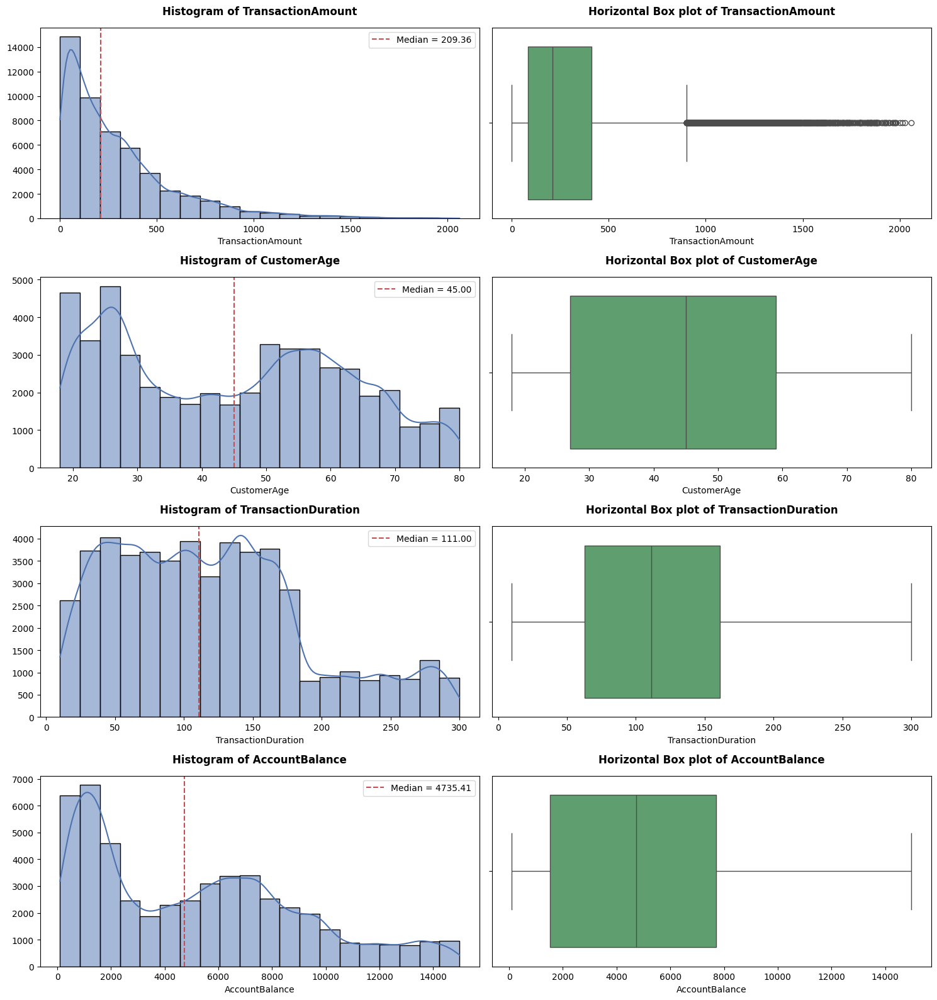

In [105]:
def plot_numerical_features(df=df_bank_transactions, numerical_features = num_features):
    fig, ax = plt.subplots(len(numerical_features), 2, figsize=(15, len(numerical_features)*4))
    ax = np.atleast_2d(ax)

    for i, feature in enumerate(numerical_features):
        sns.histplot(data=df[feature], color="#4C72B0", bins = 20, kde=True, ax=ax[i, 0])
        ax[i, 0].set_title(f"Histogram of {feature}", weight="bold", fontsize=12, pad=15)
        ax[i, 0].set_ylabel("")
        ax[i, 0].axvline(df[feature].median(), color="#C44E52", linestyle="--", label=f"Median = {df[feature].median():.2f}")
        ax[i, 0].legend()

        sns.boxplot(data=df[feature], color="#55A868", orient="h", ax=ax[i, 1])
        ax[i, 1].set_title(f"Horizontal Box plot of {feature}", weight="bold", fontsize=12, pad=15)
        ax[i, 1].set_xlabel(feature)
    plt.tight_layout()
    plt.show()

plot_numerical_features()

In [106]:
def check_skewness(data=df_bank_transactions, numerical_features=num_features, 
                   highlight=True, sort=True):
    """
    Calculate and display skewness for numerical features in a dataset.
    Optionally highlights highly skewed features and sorts the output.
    """

    # Dictionary to store skewness values
    skewness_dict = {}

    # List to collect features with strong skewness (for return)
    skew_feature = []

    # Compute skewness for each numerical feature
    for feature in numerical_features:
        skew = data[feature].skew(skipna=True)
        skewness_dict[feature] = skew

    # Convert results to DataFrame
    skew_df = pd.DataFrame.from_dict(skewness_dict, orient="index", 
                                     columns=["Skewness"])

    # Sort by absolute skewness if enabled
    if sort:
        skew_df = skew_df.reindex(skew_df["Skewness"].abs()
                                  .sort_values(ascending=False).index)

    # Print formatted skewness table
    print(f"\n[i] Skewness for dataset:")
    print("-" * 70)
    print(f"{'Feature':<30} | {'Skewness':<10} | {'Remark'}")
    print("-" * 70)

    # Iterate through features to print and classify skewness
    for feature, row in skew_df.iterrows():
        skew = row["Skewness"]
        abs_skew = abs(skew)

        # Categorize skewness level
        if abs_skew > 1:
            remark = "Highly skewed"
            color = "\033[91m"      # Red for strong skewness
        elif abs_skew > 0.5:
            remark = "Moderately skewed"
            color = "\033[93m"      # Yellow for moderate skewness
        else:
            remark = "Approximately symmetric"
            color = ""

        # End color formatting if applied
        endc = "\033[0m" if color else ""

        # Print with optional highlighting
        if highlight and color:
            print(f"{color}{feature:<30} | {skew:>+10f} | {remark}{endc}")
            skew_feature.append(feature)
        else:
            print(f"{feature:<30} | {skew:>+10f} | {remark}")

    print("-" * 70)

    return skew_feature, skew_df

skew_feature, skew_df = check_skewness()


[i] Skewness for dataset:
----------------------------------------------------------------------
Feature                        | Skewness   | Remark
----------------------------------------------------------------------
TransactionAmount              |  +1.765477 | Highly skewed
TransactionDuration            |  +0.615658 | Moderately skewed
AccountBalance                 |  +0.594983 | Moderately skewed
CustomerAge                    |  +0.151102 | Approximately symmetric
----------------------------------------------------------------------


**Insight**

* **TransactionAmount:** Highly right-skewed (+1.74) → most transactions are small, with a few large outliers (possible anomalies).
* **AccountBalance:** Moderately right-skewed (+0.60) → majority of customers have mid-range balances; few with very high balances.
* **TransactionDuration:** Moderately right-skewed (+0.60) → most transactions are short, a few unusually long ones.
* **CustomerAge:** Nearly symmetric (+0.15) → balanced age distribution across customers.

👉 Data shows **right-skewed distributions** for monetary and time-based variables, suggesting the presence of **rare high-value or long-duration transactions** — potential indicators for anomaly detection.

## Categorical Feature Distributions

**Categorical Features – Visualization Feasibility**

Although all of the following are **categorical columns**, not all are meaningful for **distribution visualization**:

* **Recommended for Visualization**

  * **`TransactionType`** → Distribution of **Credit vs. Debit** transactions (key insight).
  * **`Channel`** → Distribution across **ATM, Online, Branch**, etc.
  * **`Region`** (derived from `Location`) → Regional transaction distribution.
  * **`CustomerOccupation`** → Distribution of customer occupations, highlighting dominant groups.

* **Not Suitable for Distribution Plots**

  * **Identifiers**: `TransactionID`, `AccountID`, `DeviceID`, `MerchantID` → Mostly unique values, not insightful for frequency distribution.
  * **Time-based Variables**: `TransactionDate`, `PreviousTransactionDate` → Better analyzed via **time-series trends** (seasonality, patterns) rather than simple distributions.
  * **High Cardinality**: `IP Address` → Too many unique values, minimal insight for categorical distribution.
  * **`Location`** → More interpretable when grouped into `Region`.

**Conclusion**:
For categorical EDA, focus on **TransactionType, Channel, Region, and CustomerOccupation**.
Other categorical features will be addressed through **ID uniqueness checks, time-series analysis, or feature engineering**, rather than direct distribution plots.

In [107]:
def plot_categorical_distribution(feature, df=df_bank_transactions, order=None):
    """
    Visualize the distribution of a categorical feature using:
    - A count plot (bar plot)
    - A donut-style pie chart

    Parameters:
        feature (str): Name of the categorical column.
        df (DataFrame): Input dataframe.
        order (list): Optional custom order of category labels.
    """

    # Determine category order (use descending frequency if no custom order provided)
    feature_counts = df[feature].value_counts()
    order = order or feature_counts.index

    # Create a figure with 2 subplots (barplot + pie chart)
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

    # ===== BARPLOT =====
    sns.countplot(
        data=df, x=feature, ax=ax[0],
        palette=sns.color_palette("viridis", n_colors=len(order)),
        order=order
    )
    ax[0].set_title(
        f"Count plot of {feature}", fontsize=12, pad=15, weight="bold"
    )
    ax[0].set_xlabel("")
    ax[0].set_ylabel("")
    sns.despine(ax=ax[0], top=True, right=True, left=False, bottom=False)

    # Add data labels above each bar
    for p in ax[0].patches:
        height = p.get_height()
        ax[0].text(
            p.get_x() + p.get_width() / 2,
            height + max(feature_counts) * 0.01,
            f"{int(height)}",
            ha="center", va="bottom",
            fontsize=10, color="black"
        )

    # ===== PIE CHART (Donut Style) =====
    wedges, texts, autotexts = ax[1].pie(
        feature_counts[order],
        labels=order,
        autopct="%1.1f%%",
        startangle=90,
        colors=sns.color_palette("viridis", n_colors=len(order)),
        wedgeprops=dict(width=0.4, edgecolor="w"),  # donut width + edge styling
        radius=1.2
    )

    # Adjust font size for labels and percentages
    for text in texts + autotexts:
        text.set_fontsize(10)

    # Add white circle at the center to form a donut chart
    centre_circle = plt.Circle((0, 0), 0.70, fc="white")
    ax[1].add_artist(centre_circle)

    ax[1].set_title(
        f"Percentage Distribution of {feature}",
        fontsize=12, pad=15, weight="bold"
    )
    ax[1].axis("equal")  # Ensure perfect circle

    plt.tight_layout()
    plt.show()

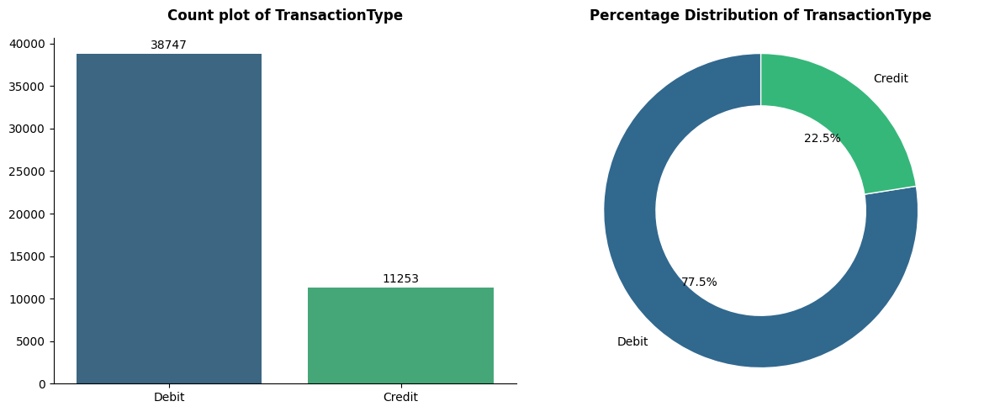

In [108]:
plot_categorical_distribution(feature="TransactionType")

**Insight**

- The bar chart clearly shows that **Debit** transactions are significantly more frequent than **Credit** transactions.
- It shows that **Debit** transactions account for approximately 77.5% of the total transactions, while **Credit** transactions constitute around 22.5%.

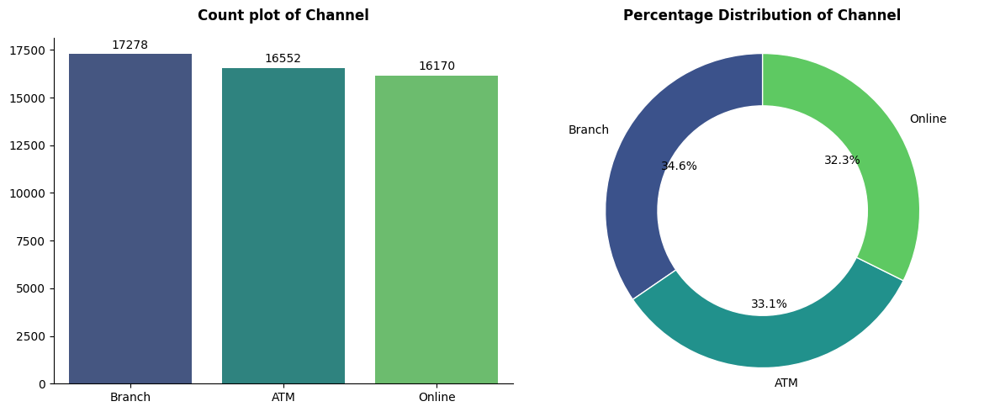

In [109]:
plot_categorical_distribution(feature="Channel")

**Insight**

* **Branch** transactions are the most common (34.6%), followed by **ATM (33.2%)** and **Online (32.3%)**.
* The distribution is **well-balanced**, showing that customers use all three channels almost equally — indicating **diverse banking behavior**.

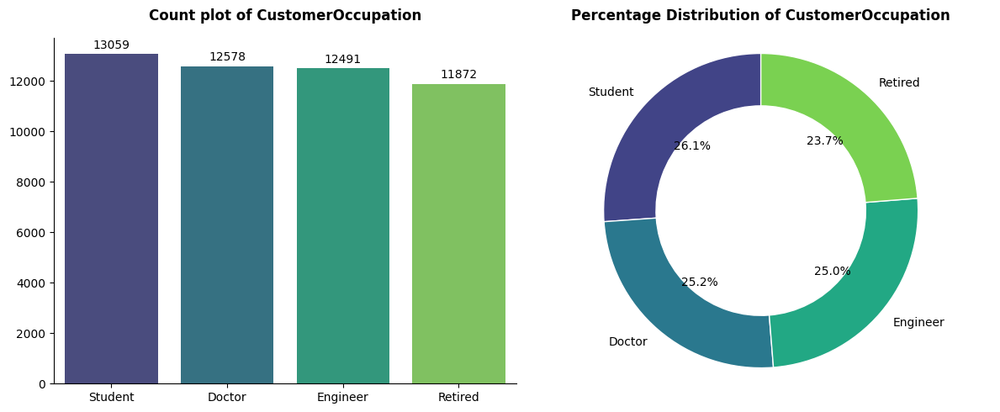

In [110]:
plot_categorical_distribution(feature="CustomerOccupation")

**Insight**

* **Students** make up the largest group (26.2%), followed by **Doctors (25.1%)**, **Engineers (24.9%)**, and **Retired (23.8%)**.
* The distribution is **fairly balanced**, indicating a **diverse and unbiased customer base**, suitable for building generalized detection models.

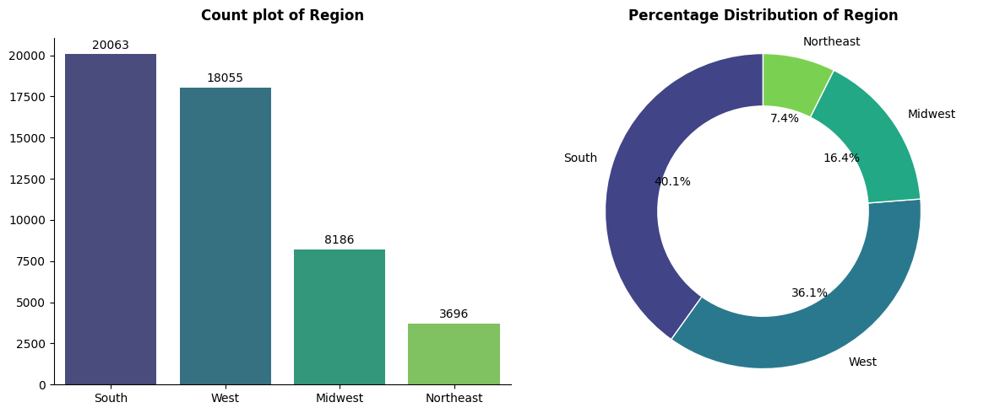

In [111]:
# Mapping city -> region
region_map = {
    # Northeast
    "New York": "Northeast",
    "Philadelphia": "Northeast",
    "Boston": "Northeast",
    
    # Midwest
    "Chicago": "Midwest",
    "Detroit": "Midwest",
    "Columbus": "Midwest",
    "Indianapolis": "Midwest",
    "Milwaukee": "Midwest",
    "Omaha": "Midwest",
    "Kansas City": "Midwest",
    
    # South
    "Dallas": "South",
    "Houston": "South",
    "San Antonio": "South",
    "Austin": "South",
    "Fort Worth": "South",
    "Charlotte": "South",
    "Memphis": "South",
    "Atlanta": "South",
    "Miami": "South",
    "Virginia Beach": "South",
    "Nashville": "South",
    "Louisville": "South",
    "Oklahoma City": "South",
    "Baltimore": "South",
    "Washington": "South",
    "Jacksonville": "South",
    "Raleigh": "South",
    
    # West
    "Los Angeles": "West",
    "San Diego": "West",
    "San Jose": "West",
    "San Francisco": "West",
    "Seattle": "West",
    "Portland": "West",
    "Phoenix": "West",
    "Las Vegas": "West",
    "Denver": "West",
    "Albuquerque": "West",
    "Fresno": "West",
    "Sacramento": "West",
    "Mesa": "West",
    "Colorado Springs": "West",
    "Tucson": "West",
    "El Paso": "West",
}

# Apply mapping
df_bank_transactions["Region"] = df_bank_transactions["Location"].map(region_map)
# df_bank_transactions = df_bank_transactions.drop(columns=["Location"])
plot_categorical_distribution(feature="Region")

**Insight**

* The bar chart shows that **South (20063)** and **West (18055)** account for the largest share of transactions, far surpassing **Midwest (8186)** and **Northeast (3696)**.
* The percentage distribution reflects this as well:

  * **South**: \~40.1%
  * **West**: \~36.1%
  * **Midwest**: \~16.4%
  * **Northeast**: \~7.4%
* This indicates that most transactions are concentrated in the **South and West regions**, while the **Northeast** records the lowest transaction activity.

## RFM Analysis

In [112]:
# Convert 2 date columns to datetime type.
df_bank_transactions["TransactionDate"] = pd.to_datetime(df_bank_transactions["TransactionDate"], format="mixed")

# Define the reference date = the latest transaction date + 1 day
# +1 day is added to avoid Recency = 0 for customers who transacted on the last day
recency_date = df_bank_transactions["TransactionDate"].max() + pd.Timedelta(days=1)

# Calculate RFM for each customer (AccountID)
rfm_df = df_bank_transactions.groupby("AccountID").agg({
    # Recency = (reference date - most recent transaction date of the customer)
    "TransactionDate": lambda x: (recency_date - x.max()).days,
    
    # Frequency = number of transactions (count unique TransactionID)
    "TransactionID": "nunique",
    
    # Monetary = total transaction amount
    "TransactionAmount": "sum"
}).reset_index()

# Rename columns for better readability
rfm_df.columns = ["AccountID", "Recency", "Frequency", "Monetary"]

display(rfm_df.head())

,AccountID,Recency,Frequency,Monetary
0,AC00001,8,46,4721.14
1,AC00002,5,142,44530.62
2,AC00003,85,95,26203.14
3,AC00004,18,199,47933.14
4,AC00005,7,175,57885.11


In [113]:
# Recency scoring: lower recency = better (more recent purchase)
def r_score(value, r_quartiles):
    if value >= r_quartiles[0.8]:
        return 1
    elif value >= r_quartiles[0.6]:
        return 2
    elif value >= r_quartiles[0.4]:
        return 3
    elif value >= r_quartiles[0.2]:
        return 4
    else:
        return 5

# Frequency scoring: higher frequency = better
def f_score(value, f_quartiles):
    if value >= f_quartiles[0.8]:
        return 5
    elif value >= f_quartiles[0.6]:
        return 4
    elif value >= f_quartiles[0.4]:
        return 3
    elif value >= f_quartiles[0.2]:
        return 2
    else:
        return 1
    
# Monetary scoring: higher monetary value = better
def m_score(value, m_quartiles):
    if value >= m_quartiles[0.8]:
        return 5
    elif value >= m_quartiles[0.6]:
        return 4
    elif value >= m_quartiles[0.4]:
        return 3
    elif value >= m_quartiles[0.2]:
        return 2
    else:
        return 1

# Compute quartiles for Recency, Frequency, Monetary
r_quartiles = rfm_df["Recency"].quantile([0.2, 0.4, 0.6, 0.8])
f_quartiles = rfm_df["Frequency"].quantile([0.2, 0.4, 0.6, 0.8])
m_quartiles = rfm_df["Monetary"].quantile([0.2, 0.4, 0.6, 0.8])

# Apply scoring functions to each customer
rfm_df["R_Score"] = rfm_df["Recency"].apply(lambda x: r_score(x, r_quartiles))
rfm_df["F_Score"] = rfm_df["Frequency"].apply(lambda x: f_score(x, f_quartiles))
rfm_df["M_Score"] = rfm_df["Monetary"].apply(lambda x: m_score(x, m_quartiles)) 

# Combine R, F, M scores into a single RFM score as a string
rfm_df["RFM_Score"] = (
    rfm_df["R_Score"].astype(str) + 
    rfm_df["F_Score"].astype(str) + 
    rfm_df["M_Score"].astype(str)
)

display(rfm_df.head())

,AccountID,Recency,Frequency,Monetary,R_Score,F_Score,M_Score,RFM_Score
0,AC00001,8,46,4721.14,4,1,1,411
1,AC00002,5,142,44530.62,4,5,4,454
2,AC00003,85,95,26203.14,1,3,3,133
3,AC00004,18,199,47933.14,3,5,5,355
4,AC00005,7,175,57885.11,4,5,5,455


In [114]:
# define a function to assign segments based on the RFM scores
def rfm_segment(score):
    if score in ["555", "554", "545", "544", "545", "455", "445"]:
        return "Champions"
    elif score in ["543", "444", "435", "355", "354", "345", "344", "335"]:
        return "Loyal"
    elif score in ["553", "551", "552", "541", "542", "533", "532", "531", "452", "451", "442", "441", 
                   "431", "453", "433", "432", "423", "353", "352", "351", "342", "341", "333", "323"]:
        return "Potential Loyalist"
    elif score in ["525", "524", "523", "522", "521", "515", "514", "513", "425", "424", "413", "414", 
                   "415", "315", "314", "313"]:
        return "Promising"
    elif score in ["512", "511", "422", "421", "412", "411", "311"]:
        return "New Customers"
    elif score in ["535", "534", "443", "434", "343", "334", "325", "324"]:
        return "Need Attention"
    elif score in ["331", "321", "312", "221", "213", "231", "241", "251"]:
        return "About To Sleep"
    elif score in ["255", "254", "245", "244", "243", "252", "243", "242", "235", "234", "225", "224",
                   "153", "152", "145", "143", "142", "135", "134", "133", "125", "124"]:
        return "At Risk"
    elif score in ["155", "154", "144", "214", "215", "115", "114", "113"]:
        return "Cannot Lose Them"
    elif score in ["332", "322", "233", "232", "223", "222", "132", "123", "122", "212", "211"]:
        return "Hibernating Customers"
    elif score in ["111", "112", "121", "131", "141", "151"]:
        return "Lost Customers"
    else:
        return "Other"

rfm_df["RFM_Segment"] = rfm_df["RFM_Score"].apply(rfm_segment)
display(rfm_df.head())

,AccountID,Recency,Frequency,Monetary,R_Score,F_Score,M_Score,RFM_Score,RFM_Segment
0,AC00001,8,46,4721.14,4,1,1,411,New Customers
1,AC00002,5,142,44530.62,4,5,4,454,Other
2,AC00003,85,95,26203.14,1,3,3,133,At Risk
3,AC00004,18,199,47933.14,3,5,5,355,Loyal
4,AC00005,7,175,57885.11,4,5,5,455,Champions


In [115]:
# Create a styled RFM summary table grouped by RFM segments
summary_rfm = (
    rfm_df.groupby("RFM_Segment").agg({
        "Recency": ["mean", "min", "max"],     # Recency statistics
        "Frequency": ["mean", "min", "max"],   # Frequency statistics
        "Monetary": ["mean", "min", "max"],    # Monetary statistics
        "AccountID": "count"                   # Number of customers in each segment
    })
    # Sort segments by highest average Monetary value
    .sort_values(("Monetary", "mean"), ascending=False)
    
    # Convert DataFrame into a styled display object
    .style
    .set_caption("RFM Summary by Segment")     # Add a centered title
    .format(precision=0)                       # Round all numeric values to 0 decimals
    
    # Apply styling for table headers and caption
    .set_table_styles([
        {"selector": "th", "props": [("text-align", "center")]},  # Center-align column headers
        {"selector": "caption", 
         "props": [("caption-side", "top"), 
                   ("font-size", "16px"), 
                   ("font-weight", "bold")]}                      # Style caption/title
    ])
    
    # Apply general formatting to all cells
    .set_properties(**{
        "text-align": "center",
        "font-size": "12px"
    })
    
    # Apply color gradient to key metrics for visual emphasis
    .background_gradient(
        subset=[
            ("Recency", "mean"),
            ("Frequency", "mean"),
            ("Monetary", "mean"),
            ("AccountID", "count")
        ],
        cmap="Greens"
    )
)

# Display the styled summary table
display(summary_rfm)

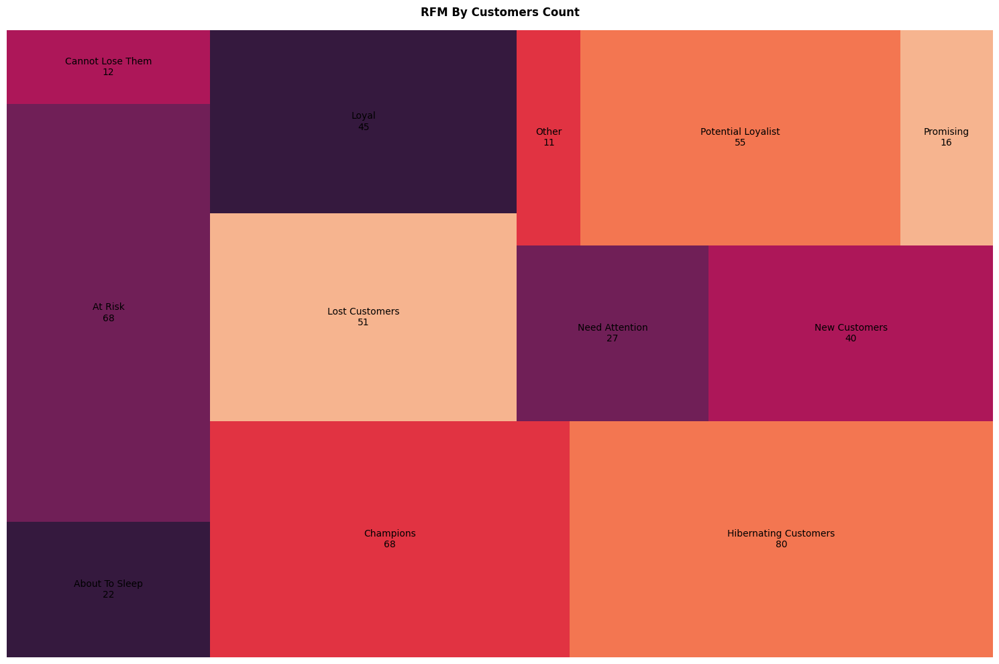

In [116]:
import squarify

# Ensure R, F, M scores are stored as small integers for efficiency
rfm_df = rfm_df.astype({
    "R_Score": "int8",
    "F_Score": "int8",
    "M_Score": "int8"
})

# Aggregate RFM metrics by segment
rfm_summarised = (
    rfm_df.groupby(by="RFM_Segment", as_index=False)
          .agg(
                customersCount=("AccountID", "nunique"),  # Unique customers per segment
                total_R=("R_Score", "sum"),               # Sum of Recency scores
                total_F=("F_Score", "sum"),               # Sum of Frequency scores
                total_M=("M_Score", "sum")                # Sum of Monetary scores
          )
)

# Create a treemap visualization of customer counts by RFM segment
plt.figure(figsize=(15, 10))

squarify.plot(
    sizes=rfm_summarised["customersCount"].to_list(),             # Area of each block
    label=rfm_summarised["RFM_Segment"] + "\n" + 
          rfm_summarised["customersCount"].astype(str),           # Segment name + count
    color=color_(n_colors=rfm_df["RFM_Segment"].nunique(),         # Custom color palette
                 tone="rocket")
)

plt.title("RFM By Customers Count", fontsize=12, pad=15, weight="bold")
plt.axis("off")     # Remove axis for cleaner treemap
plt.tight_layout()
plt.show()

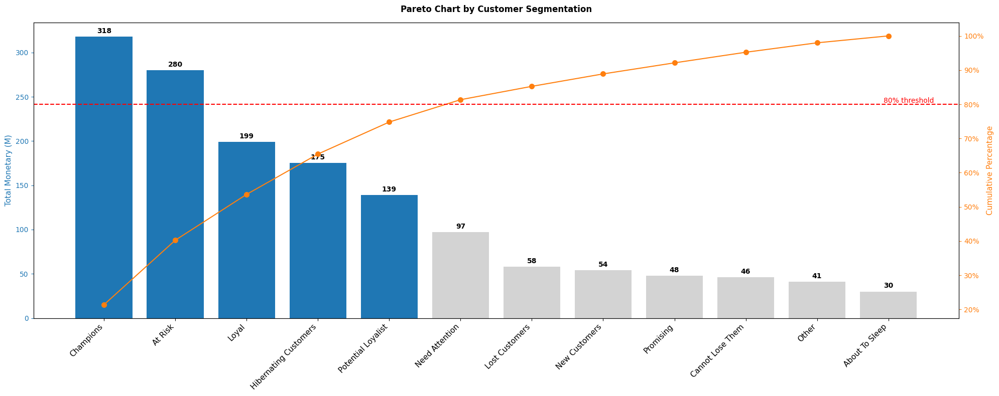

In [117]:
from matplotlib.ticker import PercentFormatter

# Sort segments by Monetary value (descending)
rfm_summarised = rfm_summarised.sort_values(by="total_M", ascending=False)

# Compute cumulative percentage for Pareto analysis
rfm_summarised["cumpercentage"] = (rfm_summarised["total_M"].cumsum() / rfm_summarised["total_M"].sum() * 100)

# Identify which segments fall within the top 80%
rfm_summarised["Top80"] = rfm_summarised["cumpercentage"] <= 80

# PARETO CHART
fig, ax = plt.subplots(figsize=(20, 8))

# Color bars: Blue for top 80%, gray for the remaining 20%
colors = ["#1f77b4" if x else "#d3d3d3" for x in rfm_summarised["Top80"]]
bars = ax.bar(
    rfm_summarised["RFM_Segment"],
    rfm_summarised["total_M"],
    color=colors
)

# Add value labels on bars
ax.bar_label(
    bars,
    labels=[f"{v:,.0f}" for v in rfm_summarised["total_M"]],
    padding=3,
    fontsize=10,
    color="black",
    weight="bold"
)

#  CUMULATIVE % LINE (Pareto)

# Create secondary y-axis
ax1 = ax.twinx()

# Plot cumulative percentage line
ax1.plot(
    rfm_summarised["RFM_Segment"],
    rfm_summarised["cumpercentage"],
    color="#ff7f0e",
    marker="o",
    ms=7
)

# Format secondary y-axis as percent
ax1.yaxis.set_major_formatter(PercentFormatter())

# Draw horizontal 80% reference line
ax1.axhline(80, color="red", linestyle="--", linewidth=1.5)
ax1.text(
    len(rfm_summarised) * 0.97,
    80,
    "80% threshold",
    color="red",
    fontsize=10,
    ha="right",
    va="bottom"
)


# LABELS & STYLING
ax.set_ylabel("Total Monetary (M)", color="C0", fontsize=11)
ax1.set_ylabel("Cumulative Percentage", color="#ff7f0e", fontsize=11)

ax.tick_params(axis="y", colors="C0")
ax1.tick_params(axis="y", colors="#ff7f0e")

# Rotate x-axis labels for readability
plt.sca(ax)
plt.xticks(rotation=45, ha="right", fontsize=11)

plt.title(
    "Pareto Chart by Customer Segmentation",
    fontsize=12,
    pad=15,
    weight="bold"
)

fig.tight_layout()
plt.show()

**Insight**

* Top **5 customer segments** (Champions → Hibernating Customers) contribute **~80% of total revenue**.
* Remaining segments (Need Attention → Promising) generate only **~20%**.

## Cohort Analysis

### Customer Retention

In [118]:
df_bank_transactions_cohort = df_bank_transactions.copy()

In [119]:
from operator import attrgetter

# TransactionDate
df_bank_transactions_cohort["cohort"] = df_bank_transactions_cohort.groupby("AccountID")["TransactionDate"].transform("min").dt.to_period("M")
df_bank_transactions_cohort["order_month"] = df_bank_transactions_cohort["TransactionDate"].dt.to_period("M")
# Create cohort dataframe
df_cohort = df_bank_transactions_cohort.groupby(["cohort", "order_month"]).agg(n_customers=("AccountID", "nunique")).reset_index(drop=False)

# period_number
df_cohort["period_number"] = (df_cohort.order_month - df_cohort.cohort).apply(attrgetter("n"))
display(df_cohort.head())

,cohort,order_month,n_customers,period_number
0,2020-01,2020-01,350,0
1,2020-01,2020-02,262,1
2,2020-01,2020-03,261,2
3,2020-01,2020-04,265,3
4,2020-01,2020-05,264,4


In [120]:
cohort_pivot = df_cohort.pivot_table(index="cohort", columns="period_number", values="n_customers")
display(cohort_pivot)

period_number,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-01,350.0,262.0,261.0,265.0,264.0,255.0,248.0,269.0,259.0,270.0,261.0,279.0,264.0,235.0,266.0,261.0,261.0,253.0,254.0,269.0,260.0,273.0,254.0,265.0,269.0,250.0,249.0,254.0,261.0,257.0,266.0,265.0,267.0,263.0,259.0,266.0,300.0,277.0,287.0,283.0,296.0,273.0,281.0,296.0,285.0,299.0,288.0,288.0,273.0,255.0,257.0,257.0,249.0,261.0,264.0,265.0,258.0,266.0,253.0,266.0,262.0,247.0,258.0,265.0,251.0,242.0,260.0,263.0,251.0,261.0,252.0,268.0
2020-02,79.0,50.0,48.0,53.0,47.0,49.0,49.0,43.0,42.0,52.0,57.0,51.0,44.0,45.0,52.0,46.0,52.0,53.0,61.0,51.0,54.0,59.0,47.0,51.0,49.0,44.0,47.0,46.0,49.0,48.0,49.0,52.0,47.0,54.0,49.0,62.0,50.0,55.0,57.0,57.0,60.0,55.0,62.0,58.0,60.0,62.0,60.0,50.0,50.0,50.0,55.0,52.0,51.0,48.0,52.0,53.0,47.0,47.0,46.0,49.0,50.0,53.0,53.0,46.0,52.0,53.0,53.0,51.0,52.0,47.0,57.0,NaN
2020-03,33.0,20.0,20.0,20.0,14.0,21.0,17.0,21.0,17.0,20.0,18.0,16.0,20.0,15.0,17.0,17.0,18.0,19.0,16.0,21.0,12.0,14.0,15.0,19.0,19.0,19.0,18.0,22.0,14.0,18.0,24.0,17.0,15.0,19.0,24.0,21.0,19.0,20.0,20.0,19.0,22.0,23.0,20.0,29.0,23.0,23.0,20.0,12.0,24.0,17.0,22.0,18.0,18.0,16.0,18.0,21.0,11.0,21.0,20.0,22.0,19.0,17.0,18.0,18.0,19.0,14.0,15.0,14.0,22.0,20.0,NaN,NaN
2020-04,14.0,7.0,6.0,10.0,7.0,7.0,5.0,9.0,3.0,9.0,5.0,8.0,7.0,4.0,7.0,7.0,4.0,7.0,3.0,8.0,8.0,6.0,8.0,5.0,4.0,7.0,4.0,6.0,3.0,3.0,5.0,3.0,7.0,8.0,7.0,9.0,5.0,7.0,9.0,4.0,8.0,6.0,7.0,9.0,7.0,8.0,8.0,5.0,9.0,7.0,8.0,8.0,6.0,10.0,5.0,7.0,3.0,6.0,3.0,7.0,6.0,6.0,6.0,7.0,6.0,6.0,5.0,7.0,4.0,NaN,NaN,NaN
2020-05,7.0,2.0,5.0,3.0,3.0,4.0,4.0,1.0,2.0,3.0,3.0,4.0,3.0,3.0,2.0,4.0,4.0,3.0,1.0,4.0,5.0,2.0,4.0,2.0,4.0,1.0,4.0,3.0,3.0,3.0,4.0,2.0,4.0,3.0,4.0,2.0,2.0,4.0,1.0,3.0,5.0,5.0,2.0,6.0,3.0,1.0,4.0,3.0,4.0,5.0,5.0,6.0,1.0,7.0,3.0,2.0,3.0,4.0,3.0,1.0,3.0,2.0,4.0,2.0,3.0,2.0,1.0,2.0,NaN,NaN,NaN,NaN
2020-06,4.0,3.0,2.0,3.0,1.0,NaN,2.0,4.0,2.0,1.0,3.0,3.0,2.0,3.0,2.0,3.0,1.0,2.0,1.0,2.0,3.0,3.0,2.0,2.0,2.0,1.0,1.0,3.0,2.0,3.0,1.0,3.0,4.0,2.0,2.0,3.0,2.0,2.0,3.0,4.0,3.0,2.0,4.0,2.0,3.0,1.0,2.0,3.0,1.0,3.0,3.0,1.0,4.0,3.0,1.0,3.0,NaN,3.0,1.0,1.0,3.0,2.0,3.0,2.0,2.0,3.0,2.0,NaN,NaN,NaN,NaN,NaN
2020-07,3.0,NaN,1.0,1.0,NaN,NaN,1.0,NaN,2.0,1.0,1.0,2.0,1.0,3.0,2.0,1.0,2.0,1.0,NaN,1.0,1.0,1.0,1.0,2.0,1.0,1.0,2.0,2.0,1.0,2.0,2.0,3.0,NaN,1.0,2.0,2.0,NaN,1.0,2.0,1.0,1.0,1.0,1.0,1.0,3.0,3.0,2.0,1.0,NaN,1.0,1.0,1.0,NaN,1.0,1.0,2.0,NaN,NaN,3.0,1.0,NaN,NaN,1.0,2.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN
2020-11,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12,2.0,NaN,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,1.0,2.0,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,NaN,NaN,1.0,1.0,1.0,NaN,1.0,NaN,NaN,1.0,1.0,2.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


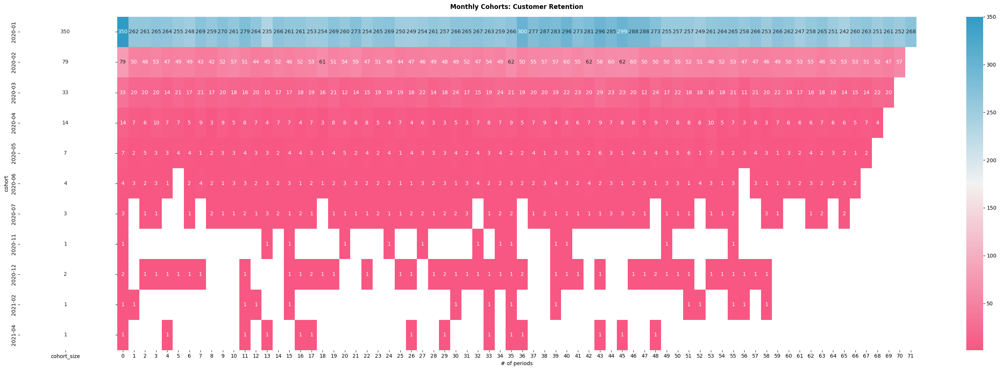

In [121]:
import matplotlib.colors as mcolors

cohort_size = cohort_pivot.iloc[:, 0]
fig, ax = plt.subplots(1, 2, figsize=(30, 10), sharey=True, gridspec_kw={"width_ratios": [1, 11]})
cmap = sns.diverging_palette(0, 230, 90, 60, as_cmap=True)
# retention matrix
sns.heatmap(cohort_pivot, mask=cohort_pivot.isnull(), annot=True, fmt=".0f", cmap=cmap, ax=ax[1])
ax[1].set_title("Monthly Cohorts: Customer Retention", fontsize=12, pad=15, weight="bold")
ax[1].set(xlabel="# of periods", ylabel="")

# cohort size
cohort_size_df = pd.DataFrame(cohort_size).rename(columns={0: "cohort_size"})
white_cmap = mcolors.ListedColormap(["white"])
sns.heatmap(cohort_size_df, annot=True, cbar=False, fmt="g", cmap=white_cmap, ax=ax[0])

plt.tight_layout()
plt.show()

In [122]:
retention_matrix = cohort_pivot.divide(cohort_size, axis=0)
retention_matrix

period_number,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-01,1.0,0.748571,0.745714,0.757143,0.754286,0.728571,0.708571,0.768571,0.740000,0.771429,0.745714,0.797143,0.754286,0.671429,0.760000,0.745714,0.745714,0.722857,0.725714,0.768571,0.742857,0.780000,0.725714,0.757143,0.768571,0.714286,0.711429,0.725714,0.745714,0.734286,0.760000,0.757143,0.762857,0.751429,0.740000,0.760000,0.857143,0.791429,0.820000,0.808571,0.845714,0.780000,0.802857,0.845714,0.814286,0.854286,0.822857,0.822857,0.780000,0.728571,0.734286,0.734286,0.711429,0.745714,0.754286,0.757143,0.737143,0.760000,0.722857,0.760000,0.748571,0.705714,0.737143,0.757143,0.717143,0.691429,0.742857,0.751429,0.717143,0.745714,0.720000,0.765714
2020-02,1.0,0.632911,0.607595,0.670886,0.594937,0.620253,0.620253,0.544304,0.531646,0.658228,0.721519,0.645570,0.556962,0.569620,0.658228,0.582278,0.658228,0.670886,0.772152,0.645570,0.683544,0.746835,0.594937,0.645570,0.620253,0.556962,0.594937,0.582278,0.620253,0.607595,0.620253,0.658228,0.594937,0.683544,0.620253,0.784810,0.632911,0.696203,0.721519,0.721519,0.759494,0.696203,0.784810,0.734177,0.759494,0.784810,0.759494,0.632911,0.632911,0.632911,0.696203,0.658228,0.645570,0.607595,0.658228,0.670886,0.594937,0.594937,0.582278,0.620253,0.632911,0.670886,0.670886,0.582278,0.658228,0.670886,0.670886,0.645570,0.658228,0.594937,0.721519,NaN
2020-03,1.0,0.606061,0.606061,0.606061,0.424242,0.636364,0.515152,0.636364,0.515152,0.606061,0.545455,0.484848,0.606061,0.454545,0.515152,0.515152,0.545455,0.575758,0.484848,0.636364,0.363636,0.424242,0.454545,0.575758,0.575758,0.575758,0.545455,0.666667,0.424242,0.545455,0.727273,0.515152,0.454545,0.575758,0.727273,0.636364,0.575758,0.606061,0.606061,0.575758,0.666667,0.696970,0.606061,0.878788,0.696970,0.696970,0.606061,0.363636,0.727273,0.515152,0.666667,0.545455,0.545455,0.484848,0.545455,0.636364,0.333333,0.636364,0.606061,0.666667,0.575758,0.515152,0.545455,0.545455,0.575758,0.424242,0.454545,0.424242,0.666667,0.606061,NaN,NaN
2020-04,1.0,0.500000,0.428571,0.714286,0.500000,0.500000,0.357143,0.642857,0.214286,0.642857,0.357143,0.571429,0.500000,0.285714,0.500000,0.500000,0.285714,0.500000,0.214286,0.571429,0.571429,0.428571,0.571429,0.357143,0.285714,0.500000,0.285714,0.428571,0.214286,0.214286,0.357143,0.214286,0.500000,0.571429,0.500000,0.642857,0.357143,0.500000,0.642857,0.285714,0.571429,0.428571,0.500000,0.642857,0.500000,0.571429,0.571429,0.357143,0.642857,0.500000,0.571429,0.571429,0.428571,0.714286,0.357143,0.500000,0.214286,0.428571,0.214286,0.500000,0.428571,0.428571,0.428571,0.500000,0.428571,0.428571,0.357143,0.500000,0.285714,NaN,NaN,NaN
2020-05,1.0,0.285714,0.714286,0.428571,0.428571,0.571429,0.571429,0.142857,0.285714,0.428571,0.428571,0.571429,0.428571,0.428571,0.285714,0.571429,0.571429,0.428571,0.142857,0.571429,0.714286,0.285714,0.571429,0.285714,0.571429,0.142857,0.571429,0.428571,0.428571,0.428571,0.571429,0.285714,0.571429,0.428571,0.571429,0.285714,0.285714,0.571429,0.142857,0.428571,0.714286,0.714286,0.285714,0.857143,0.428571,0.142857,0.571429,0.428571,0.571429,0.714286,0.714286,0.857143,0.142857,1.000000,0.428571,0.285714,0.428571,0.571429,0.428571,0.142857,0.428571,0.285714,0.571429,0.285714,0.428571,0.285714,0.142857,0.285714,NaN,NaN,NaN,NaN
2020-06,1.0,0.750000,0.500000,0.750000,0.250000,NaN,0.500000,1.000000,0.500000,0.250000,0.750000,0.750000,0.500000,0.750000,0.500000,0.750000,0.250000,0.500000,0.250000,0.500000,0.750000,0.750000,0.500000,0.500000,0.500000,0.250000,0.250000,0.750000,0.500000,0.750000,0.250000,0.750000,1.000000,0.500000,0.500000,0.750000,0.500000,0.500000,0.750000,1.000000,0.750000,0.500000,1.000000,0.500000,0.750000,0.250000,0.500000,0.750000,0.250000,0.750000,0.750000,0.250000,1.000000,0.750000,0.250000,0.7

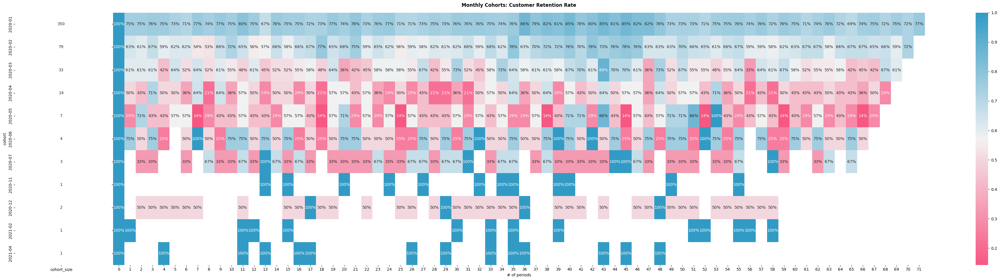

In [123]:
fig, ax = plt.subplots(1, 2, figsize=(40, 10), sharey=True, gridspec_kw={"width_ratios": [1, 11]})
cmap = sns.diverging_palette(0, 230, 90, 60, as_cmap=True)
# retention matrix
sns.heatmap(retention_matrix, mask=retention_matrix.isnull(), annot=True, fmt=".0%", cmap=cmap, ax=ax[1])
ax[1].set_title("Monthly Cohorts: Customer Retention Rate", fontsize=12, pad=15, weight="bold")
ax[1].set(xlabel="# of periods", ylabel="")

# cohort size
cohort_size_df = pd.DataFrame(cohort_size).rename(columns={0: "cohort_size"})
white_cmap = mcolors.ListedColormap(["white"])
sns.heatmap(cohort_size_df, annot=True, cbar=False, fmt="g", cmap=white_cmap, ax=ax[0])

plt.tight_layout()
plt.show()

### Customer Churn

In [124]:
base = cohort_pivot[0]
n_customer_churn = cohort_pivot.apply(lambda col: base - col, axis=0)
n_customer_churn[0] = base
n_customer_churn

period_number,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-01,350.0,88.0,89.0,85.0,86.0,95.0,102.0,81.0,91.0,80.0,89.0,71.0,86.0,115.0,84.0,89.0,89.0,97.0,96.0,81.0,90.0,77.0,96.0,85.0,81.0,100.0,101.0,96.0,89.0,93.0,84.0,85.0,83.0,87.0,91.0,84.0,50.0,73.0,63.0,67.0,54.0,77.0,69.0,54.0,65.0,51.0,62.0,62.0,77.0,95.0,93.0,93.0,101.0,89.0,86.0,85.0,92.0,84.0,97.0,84.0,88.0,103.0,92.0,85.0,99.0,108.0,90.0,87.0,99.0,89.0,98.0,82.0
2020-02,79.0,29.0,31.0,26.0,32.0,30.0,30.0,36.0,37.0,27.0,22.0,28.0,35.0,34.0,27.0,33.0,27.0,26.0,18.0,28.0,25.0,20.0,32.0,28.0,30.0,35.0,32.0,33.0,30.0,31.0,30.0,27.0,32.0,25.0,30.0,17.0,29.0,24.0,22.0,22.0,19.0,24.0,17.0,21.0,19.0,17.0,19.0,29.0,29.0,29.0,24.0,27.0,28.0,31.0,27.0,26.0,32.0,32.0,33.0,30.0,29.0,26.0,26.0,33.0,27.0,26.0,26.0,28.0,27.0,32.0,22.0,NaN
2020-03,33.0,13.0,13.0,13.0,19.0,12.0,16.0,12.0,16.0,13.0,15.0,17.0,13.0,18.0,16.0,16.0,15.0,14.0,17.0,12.0,21.0,19.0,18.0,14.0,14.0,14.0,15.0,11.0,19.0,15.0,9.0,16.0,18.0,14.0,9.0,12.0,14.0,13.0,13.0,14.0,11.0,10.0,13.0,4.0,10.0,10.0,13.0,21.0,9.0,16.0,11.0,15.0,15.0,17.0,15.0,12.0,22.0,12.0,13.0,11.0,14.0,16.0,15.0,15.0,14.0,19.0,18.0,19.0,11.0,13.0,NaN,NaN
2020-04,14.0,7.0,8.0,4.0,7.0,7.0,9.0,5.0,11.0,5.0,9.0,6.0,7.0,10.0,7.0,7.0,10.0,7.0,11.0,6.0,6.0,8.0,6.0,9.0,10.0,7.0,10.0,8.0,11.0,11.0,9.0,11.0,7.0,6.0,7.0,5.0,9.0,7.0,5.0,10.0,6.0,8.0,7.0,5.0,7.0,6.0,6.0,9.0,5.0,7.0,6.0,6.0,8.0,4.0,9.0,7.0,11.0,8.0,11.0,7.0,8.0,8.0,8.0,7.0,8.0,8.0,9.0,7.0,10.0,NaN,NaN,NaN
2020-05,7.0,5.0,2.0,4.0,4.0,3.0,3.0,6.0,5.0,4.0,4.0,3.0,4.0,4.0,5.0,3.0,3.0,4.0,6.0,3.0,2.0,5.0,3.0,5.0,3.0,6.0,3.0,4.0,4.0,4.0,3.0,5.0,3.0,4.0,3.0,5.0,5.0,3.0,6.0,4.0,2.0,2.0,5.0,1.0,4.0,6.0,3.0,4.0,3.0,2.0,2.0,1.0,6.0,0.0,4.0,5.0,4.0,3.0,4.0,6.0,4.0,5.0,3.0,5.0,4.0,5.0,6.0,5.0,NaN,NaN,NaN,NaN
2020-06,4.0,1.0,2.0,1.0,3.0,NaN,2.0,0.0,2.0,3.0,1.0,1.0,2.0,1.0,2.0,1.0,3.0,2.0,3.0,2.0,1.0,1.0,2.0,2.0,2.0,3.0,3.0,1.0,2.0,1.0,3.0,1.0,0.0,2.0,2.0,1.0,2.0,2.0,1.0,0.0,1.0,2.0,0.0,2.0,1.0,3.0,2.0,1.0,3.0,1.0,1.0,3.0,0.0,1.0,3.0,1.0,NaN,1.0,3.0,3.0,1.0,2.0,1.0,2.0,2.0,1.0,2.0,NaN,NaN,NaN,NaN,NaN
2020-07,3.0,NaN,2.0,2.0,NaN,NaN,2.0,NaN,1.0,2.0,2.0,1.0,2.0,0.0,1.0,2.0,1.0,2.0,NaN,2.0,2.0,2.0,2.0,1.0,2.0,2.0,1.0,1.0,2.0,1.0,1.0,0.0,NaN,2.0,1.0,1.0,NaN,2.0,1.0,2.0,2.0,2.0,2.0,2.0,0.0,0.0,1.0,2.0,NaN,2.0,2.0,2.0,NaN,2.0,2.0,1.0,NaN,NaN,0.0,2.0,NaN,NaN,2.0,1.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
2020-11,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-12,2.0,NaN,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,1.0,0.0,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,1.0,1.0,1.0,NaN,1.0,NaN,NaN,1.0,1.0,0.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


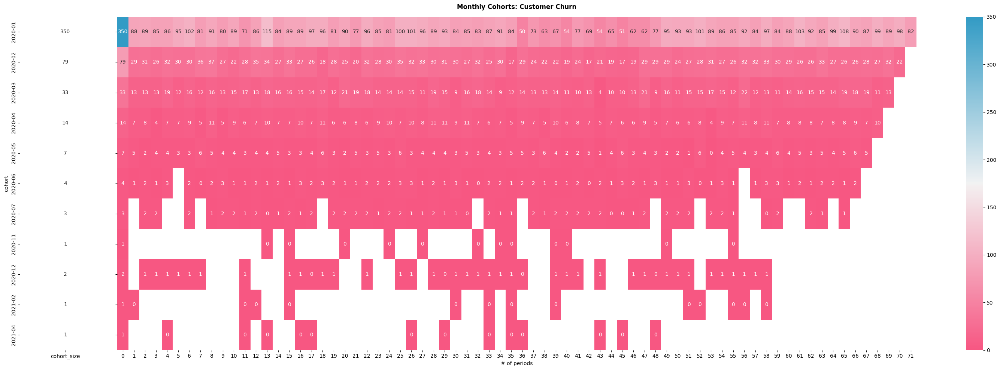

In [125]:
cohort_size_churn = n_customer_churn.iloc[:, 0]
fig, ax = plt.subplots(1, 2, figsize=(30, 10), sharey=True, gridspec_kw={"width_ratios": [1, 11]})
cmap = sns.diverging_palette(0, 230, 90, 60, as_cmap=True)
# retention matrix
sns.heatmap(n_customer_churn, mask=n_customer_churn.isnull(), annot=True, fmt=".0f", cmap=cmap, ax=ax[1])
ax[1].set_title("Monthly Cohorts: Customer Churn", fontsize=12, pad=15, weight="bold")
ax[1].set(xlabel="# of periods", ylabel="")

# cohort size
cohort_size_df = pd.DataFrame(cohort_size_churn).rename(columns={0: "cohort_size"})
white_cmap = mcolors.ListedColormap(["white"])
sns.heatmap(cohort_size_df, annot=True, cbar=False, fmt="g", cmap=white_cmap, ax=ax[0])

plt.tight_layout()
plt.show()

In [126]:
churn_rate_matrix = n_customer_churn.divide(cohort_size_churn, axis=0)
churn_rate_matrix

period_number,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71
cohort,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-01,1.0,0.251429,0.254286,0.242857,0.245714,0.271429,0.291429,0.231429,0.260000,0.228571,0.254286,0.202857,0.245714,0.328571,0.240000,0.254286,0.254286,0.277143,0.274286,0.231429,0.257143,0.220000,0.274286,0.242857,0.231429,0.285714,0.288571,0.274286,0.254286,0.265714,0.240000,0.242857,0.237143,0.248571,0.260000,0.240000,0.142857,0.208571,0.180000,0.191429,0.154286,0.220000,0.197143,0.154286,0.185714,0.145714,0.177143,0.177143,0.220000,0.271429,0.265714,0.265714,0.288571,0.254286,0.245714,0.242857,0.262857,0.240000,0.277143,0.240000,0.251429,0.294286,0.262857,0.242857,0.282857,0.308571,0.257143,0.248571,0.282857,0.254286,0.280000,0.234286
2020-02,1.0,0.367089,0.392405,0.329114,0.405063,0.379747,0.379747,0.455696,0.468354,0.341772,0.278481,0.354430,0.443038,0.430380,0.341772,0.417722,0.341772,0.329114,0.227848,0.354430,0.316456,0.253165,0.405063,0.354430,0.379747,0.443038,0.405063,0.417722,0.379747,0.392405,0.379747,0.341772,0.405063,0.316456,0.379747,0.215190,0.367089,0.303797,0.278481,0.278481,0.240506,0.303797,0.215190,0.265823,0.240506,0.215190,0.240506,0.367089,0.367089,0.367089,0.303797,0.341772,0.354430,0.392405,0.341772,0.329114,0.405063,0.405063,0.417722,0.379747,0.367089,0.329114,0.329114,0.417722,0.341772,0.329114,0.329114,0.354430,0.341772,0.405063,0.278481,NaN
2020-03,1.0,0.393939,0.393939,0.393939,0.575758,0.363636,0.484848,0.363636,0.484848,0.393939,0.454545,0.515152,0.393939,0.545455,0.484848,0.484848,0.454545,0.424242,0.515152,0.363636,0.636364,0.575758,0.545455,0.424242,0.424242,0.424242,0.454545,0.333333,0.575758,0.454545,0.272727,0.484848,0.545455,0.424242,0.272727,0.363636,0.424242,0.393939,0.393939,0.424242,0.333333,0.303030,0.393939,0.121212,0.303030,0.303030,0.393939,0.636364,0.272727,0.484848,0.333333,0.454545,0.454545,0.515152,0.454545,0.363636,0.666667,0.363636,0.393939,0.333333,0.424242,0.484848,0.454545,0.454545,0.424242,0.575758,0.545455,0.575758,0.333333,0.393939,NaN,NaN
2020-04,1.0,0.500000,0.571429,0.285714,0.500000,0.500000,0.642857,0.357143,0.785714,0.357143,0.642857,0.428571,0.500000,0.714286,0.500000,0.500000,0.714286,0.500000,0.785714,0.428571,0.428571,0.571429,0.428571,0.642857,0.714286,0.500000,0.714286,0.571429,0.785714,0.785714,0.642857,0.785714,0.500000,0.428571,0.500000,0.357143,0.642857,0.500000,0.357143,0.714286,0.428571,0.571429,0.500000,0.357143,0.500000,0.428571,0.428571,0.642857,0.357143,0.500000,0.428571,0.428571,0.571429,0.285714,0.642857,0.500000,0.785714,0.571429,0.785714,0.500000,0.571429,0.571429,0.571429,0.500000,0.571429,0.571429,0.642857,0.500000,0.714286,NaN,NaN,NaN
2020-05,1.0,0.714286,0.285714,0.571429,0.571429,0.428571,0.428571,0.857143,0.714286,0.571429,0.571429,0.428571,0.571429,0.571429,0.714286,0.428571,0.428571,0.571429,0.857143,0.428571,0.285714,0.714286,0.428571,0.714286,0.428571,0.857143,0.428571,0.571429,0.571429,0.571429,0.428571,0.714286,0.428571,0.571429,0.428571,0.714286,0.714286,0.428571,0.857143,0.571429,0.285714,0.285714,0.714286,0.142857,0.571429,0.857143,0.428571,0.571429,0.428571,0.285714,0.285714,0.142857,0.857143,0.000000,0.571429,0.714286,0.571429,0.428571,0.571429,0.857143,0.571429,0.714286,0.428571,0.714286,0.571429,0.714286,0.857143,0.714286,NaN,NaN,NaN,NaN
2020-06,1.0,0.250000,0.500000,0.250000,0.750000,NaN,0.500000,0.000000,0.500000,0.750000,0.250000,0.250000,0.500000,0.250000,0.500000,0.250000,0.750000,0.500000,0.750000,0.500000,0.250000,0.250000,0.500000,0.500000,0.500000,0.750000,0.750000,0.250000,0.500000,0.250000,0.750000,0.250000,0.000000,0.500000,0.500000,0.250000,0.500000,0.500000,0.250000,0.000000,0.250000,0.500000,0.000000,0.500000,0.250000,0.750000,0.500000,0.250000,0.750000,0.250000,0.250000,0.750000,0.000000,0.250000,0.750000,0.2

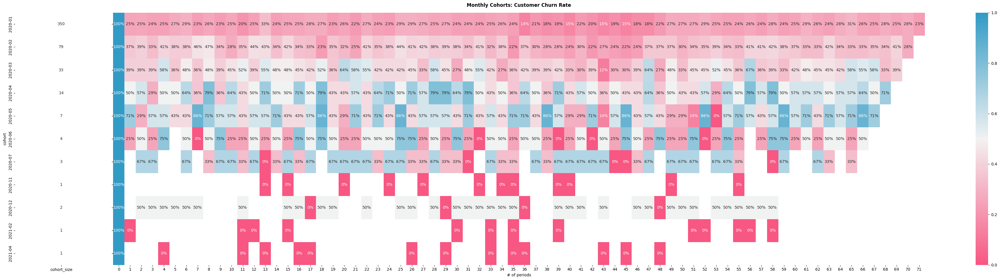

In [127]:
fig, ax = plt.subplots(1, 2, figsize=(40, 10), sharey=True, gridspec_kw={"width_ratios": [1, 11]})
cmap = sns.diverging_palette(0, 230, 90, 60, as_cmap=True)
# retention matrix
sns.heatmap(churn_rate_matrix, mask=churn_rate_matrix.isnull(), annot=True, fmt=".0%", cmap=cmap, ax=ax[1])
ax[1].set_title("Monthly Cohorts: Customer Churn Rate", fontsize=12, pad=15, weight="bold")
ax[1].set(xlabel="# of periods", ylabel="")

# cohort size
cohort_size_df = pd.DataFrame(cohort_size).rename(columns={0: "cohort_size"})
white_cmap = mcolors.ListedColormap(["white"])
sns.heatmap(cohort_size_df, annot=True, cbar=False, fmt="g", cmap=white_cmap, ax=ax[0])

plt.tight_layout()
plt.show()

**Insight**

* **Clear early churn:** most customers leave within the first 1–3 periods.
* **Large cohort (2020-01)** dominates overall trends; smaller cohorts retain fewer and vanish quickly.
* **Retention steadily declines** over time, with many cohorts dropping to zero after a few periods.
* **Churn concentrates in early stages**.

## QoQ Analysis

In [128]:
# Extract quarter period (e.g., 2020Q1) from TransactionDate
df_bank_transactions_cohort["quarter"] = (
    df_bank_transactions["TransactionDate"]
    .dt.to_period("Q")
    .astype(str)
)

# Aggregate quarterly revenue and number of unique accounts
quarterly_summary = df_bank_transactions_cohort.groupby("quarter").agg(
    revenue=("TransactionAmount", "sum"),         # Total revenue per quarter
    account_count=("AccountID", "nunique")        # Number of unique accounts per quarter
).reset_index()

# Calculate quarter-over-quarter (QoQ) revenue growth
quarterly_summary["qoq_growth"] = (
    quarterly_summary["revenue"].pct_change() * 100
)

# Round growth values for cleaner display
quarterly_summary["qoq_growth"] = quarterly_summary["qoq_growth"].round(2)

# Create a label: add "+" for positive growth, keep "–" for NaN (first row)
quarterly_summary["qoq_growth_label"] = quarterly_summary["qoq_growth"].apply(
    lambda x: f"+{x}%" if pd.notnull(x) and x > 0 
    else (f"{x}%" if pd.notnull(x) else "–")
)

# Display the first few rows for validation
display(quarterly_summary.head())

,quarter,revenue,account_count,qoq_growth,qoq_growth_label
0,2020Q1,586999.39,462,NaN,–
1,2020Q2,578895.08,463,-1.38,-1.38%
2,2020Q3,593938.10,464,2.60,+2.6%
3,2020Q4,575261.69,471,-3.14,-3.14%
4,2021Q1,574005.22,460,-0.22,-0.22%


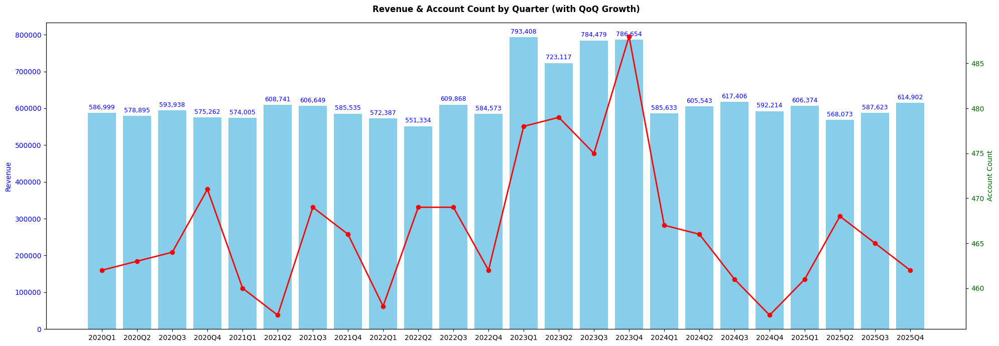

In [129]:
# Plot the chart
fig, ax1 = plt.subplots(figsize=(20, 7))

# Revenue bars
bars = ax1.bar(quarterly_summary["quarter"], quarterly_summary["revenue"],
               color="skyblue", label="Revenue")
ax1.set_ylabel("Revenue", color="blue")
ax1.tick_params(axis="y", labelcolor="blue")

# Add value labels on top of each bar
ax1.bar_label(bars, labels=[f"{v:,.0f}" for v in quarterly_summary["revenue"]],
              padding=3, fontsize=9, color="blue")

# Secondary axis for line chart (Account Count)
ax2 = ax1.twinx()
ax2.plot(quarterly_summary["quarter"], quarterly_summary["account_count"], color="red",
         marker="o", linewidth=2, label="Account Count")
ax2.set_ylabel("Account Count", color="darkgreen")
ax2.tick_params(axis="y", labelcolor="darkgreen")

# Add title and format axes
plt.title("Revenue & Account Count by Quarter (with QoQ Growth)", fontsize=12, fontweight="bold", pad=15)
fig.tight_layout()
plt.show()

**Insight**

* **Revenue** fluctuates between **570K–790K**, peaking around **2023Q1–Q4 (~790K)**.
* Strong **growth momentum in 2023**, followed by a slight decline in early 2024.
* **Account count** remains stable (around **460–485**), showing minimal variation.
* **Revenue and account trends are not synchronized** — revenue rises while account count stays flat → improved **revenue per account efficiency**.
* 👉 Revenue growth is mainly driven by **higher spending per customer**, not by an increase in account volume.

## CLV Analysis

> **CLV = Total profit a customer generates during their relationship with the company.**
> It measures **long-term customer value** and helps optimize **marketing spend, retention, and growth strategy.**

$$
CLV = (Average Purchase Value × Gross Margin) × Purchase Frequency × Lifespan
$$

* **Average Purchase Value × Gross Margin:** Profit per purchase
* **Purchase Frequency:** How often customers buy (e.g., times per year)
* **Lifespan:** Average years a customer stays active
* **Interpretation:** Total lifetime profit from an average customer.

In [130]:
# Compute average purchase value (APV), purchase frequency, and lifespan
clv_df = df_bank_transactions.groupby("AccountID").agg(
    Total_Revenue=("TransactionAmount", "sum"),
    Num_Transactions=("TransactionID", "nunique"),
    First_Purchase=("TransactionDate", "min"),
    Last_Purchase=("TransactionDate", "max")
).reset_index()

display(clv_df.head())

,AccountID,Total_Revenue,Num_Transactions,First_Purchase,Last_Purchase
0,AC00001,4721.14,46,2020-01-29,2025-12-24
1,AC00002,44530.62,142,2020-03-07,2025-12-27
2,AC00003,26203.14,95,2020-04-17,2025-10-08
3,AC00004,47933.14,199,2020-01-03,2025-12-14
4,AC00005,57885.11,175,2020-01-03,2025-12-25


[✓] Average CLV across all customers: 646799.95


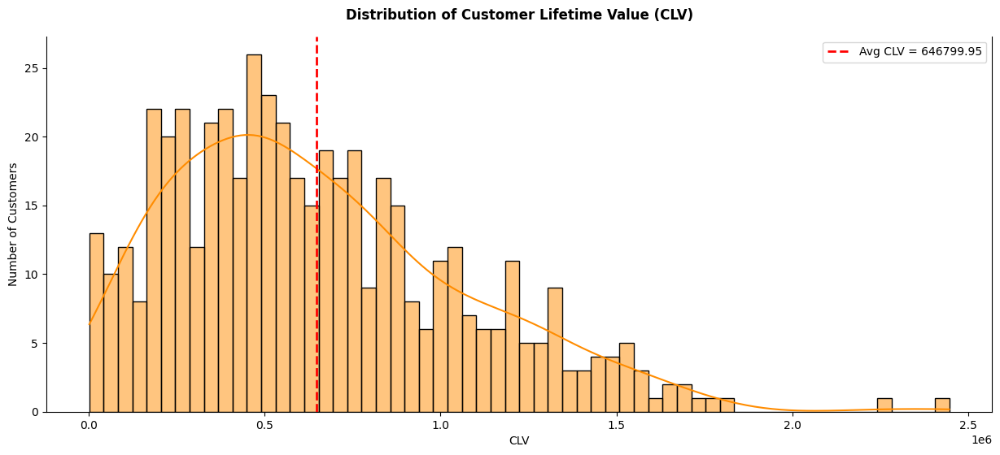

Top 10 High-Value Customers:


,AccountID,Total_Revenue,Num_Transactions,First_Purchase,Last_Purchase,APV,Frequency,Lifespan_Months,COGS,GrossMargin,CLV
0,AC00460,111652.99,238,2020-01-01,2025-12-30,469.130210,238,73.000000,78157.093,0.3,2.445200e+06
1,AC00363,103323.12,249,2020-01-04,2025-12-24,414.952289,249,72.700000,72326.184,0.3,2.253477e+06
2,AC00337,84209.46,155,2020-01-13,2025-12-04,543.286839,155,71.733333,58946.622,0.3,1.812188e+06
3,AC00095,81857.89,179,2020-01-26,2025-12-29,457.306648,179,72.133333,57300.523,0.3,1.771405e+06
4,AC00021,79093.17,153,2020-01-15,2025-12-25,516.948824,153,72.366667,55365.219,0.3,1.717113e+06
5,AC00136,77690.13,159,2020-01-20,2025-12-31,488.617170,159,72.400000,54383.091,0.3,1.687430e+06
6,AC00020,77790.96,177,2020-01-09,2025-12-14,439.496949,177,72.200000,54453.672,0.3,1.684952e+06
7,AC00202,75719.32,241,2020-01-03,2025-12-24,314.188050,241,72.733333,53003.524,0.3,1.652196e+06
8,AC00358,76168.82,156,2020-01-07,2025-12-11,488.261667,156,72.166667,53318.174,0.3,1.649055e+06
9,AC00439,74708.24,172,2020-01-11,2025-12-27,434.350233,172,72.566667,52295.768,0.3,1.626398e+06


In [131]:
# Average purchase value per transaction
clv_df["APV"] = clv_df["Total_Revenue"] / clv_df["Num_Transactions"]

# Frequency (number of transactions)
clv_df["Frequency"] = clv_df["Num_Transactions"]

# Lifespan: number of months between first and last purchase (+1 to avoid division by zero)
clv_df["Lifespan_Months"] = ((clv_df["Last_Purchase"] - clv_df["First_Purchase"]).dt.days / 30).clip(lower=1)

clv_df["COGS"] = clv_df["Total_Revenue"] * 0.7 # We assume COGS = 70% Total_Revenue.
clv_df["GrossMargin"] = (clv_df["Total_Revenue"] - clv_df["COGS"]) / clv_df["Total_Revenue"]

# Customer Lifetime Value
clv_df["CLV"] = clv_df["APV"] * clv_df["GrossMargin"] * clv_df["Frequency"] * clv_df["Lifespan_Months"]

# Calculate the average CLV across all customers ---
avg_clv = clv_df["CLV"].mean()
print(f"[✓] Average CLV across all customers: {avg_clv:.2f}")

# Plot CLV distribution with Seaborn ---
plt.figure(figsize=(15,6))
sns.histplot(clv_df["CLV"], bins=60, edgecolor="black", kde=True, color="darkorange")
sns.despine(top=True, right=False, left=False, bottom=False)

# Add vertical line for average CLV
plt.axvline(avg_clv, color="red", linestyle="dashed", linewidth=2, label=f"Avg CLV = {avg_clv:.2f}")

# Titles and labels
plt.title("Distribution of Customer Lifetime Value (CLV)", fontsize=12, fontweight="bold", pad=15)
plt.xlabel("CLV")
plt.ylabel("Number of Customers")
plt.legend()
plt.show()

# Display top customers with highest CLV (VIP customers)
print("Top 10 High-Value Customers:")
display(clv_df.sort_values(by="CLV", ascending=False).reset_index(drop=True).head(10))

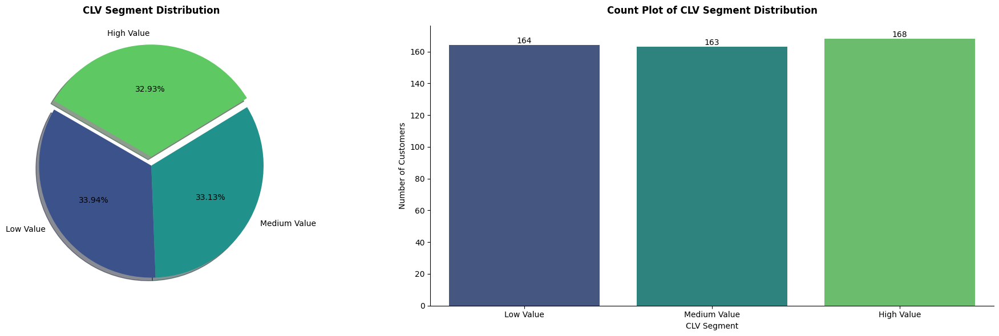

In [132]:
q33 = clv_df["CLV"].quantile(0.33)
q66 = clv_df["CLV"].quantile(0.66)

# Function to classify customers
def clv_segment(x):
    if x <= q33:
        return "Low Value"
    elif x <= q66:
        return "Medium Value"
    else:
        return "High Value"

# Add Segment column
clv_df["CLV_Segment"] = clv_df["CLV"].apply(clv_segment)

# Segment distribution
CLV_Segment_Distribution = clv_df["CLV_Segment"].value_counts()

fig, ax = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(20, 6))
n_colors = clv_df["CLV_Segment"].nunique()
viridis_colors = sns.color_palette("viridis", n_colors=n_colors)

# ax[0] – Pie chart
ax[0].pie(
    CLV_Segment_Distribution,
    labels=["Low Value", "Medium Value", "High Value"],
    colors=viridis_colors,
    autopct="%1.2f%%",
    startangle=150,
    explode=(0, 0, 0.08),
    shadow=True
)
ax[0].set_title("CLV Segment Distribution", weight="bold", fontsize=12, pad=15)

# ax[1] – Count plot
sns.countplot(
    data=clv_df,
    x="CLV_Segment",
    palette=viridis_colors,
    ax=ax[1],
    order=["Low Value", "Medium Value", "High Value"]
)
ax[1].set_title("Count Plot of CLV Segment Distribution", weight="bold", fontsize=12, pad=15)

# Add labels on top of bars
for container in ax[1].containers:
    ax[1].bar_label(container, fmt="%d", label_type="edge", fontsize=10)

ax[1].set_ylabel("Number of Customers")
ax[1].set_xlabel("CLV Segment")
sns.despine(ax=ax[1], top=True, right=True, left=False, bottom=False)

plt.tight_layout()
plt.show()

**Insights**

* Most customers have CLV **below average**, suggesting a need to **increase purchase frequency or order value**.
* The **High Value** group (~33%) should be the main focus for **retention and loyalty programs**.
* **Average CLV ≈ $647K** can serve as a **benchmark** for evaluating marketing and customer strategies.

<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Anomaly Detection</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Anomaly Detection
    </h1>
</div>


## Feature Engineering

In [133]:
# Convert TransactionDate to datetime format
df_bank_transactions["TransactionDate"] = pd.to_datetime(df_bank_transactions["TransactionDate"])

# Convert datetime to Unix timestamp (seconds since epoch)
df_bank_transactions["TransactionDate_epoch"] = (
    df_bank_transactions["TransactionDate"].astype("int64") // 10**9
)

# Extract month number from the transaction date
df_bank_transactions["Month"] = df_bank_transactions["TransactionDate"].dt.month

# Remove the original datetime column since it is no longer needed
df_bank_transactions.drop(columns=["TransactionDate"], axis=1, inplace=True)

# Selected numerical (continuous) features
num_features = [
    "TransactionAmount", 
    "CustomerAge", 
    "TransactionDuration", 
    "AccountBalance", 
    "Month", 
    "TransactionDate_epoch"
]

# Selected categorical features to convert
new_cat_features = [
    "TransactionType", 
    "Channel", 
    "Region", 
    "CustomerOccupation", 
    "LoginAttempts"
]

# Convert defined categorical columns
convert_cat(new_cat_features)

# Display updated dataframe info (memory usage + dtypes)
df_bank_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 17 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   TransactionID          50000 non-null  category
 1   AccountID              50000 non-null  category
 2   TransactionAmount      50000 non-null  float64 
 3   TransactionType        50000 non-null  category
 4   Location               50000 non-null  category
 5   DeviceID               50000 non-null  category
 6   IP Address             50000 non-null  category
 7   MerchantID             50000 non-null  category
 8   Channel                50000 non-null  category
 9   CustomerAge            50000 non-null  int64   
 10  CustomerOccupation     50000 non-null  category
 11  TransactionDuration    50000 non-null  int64   
 12  LoginAttempts          50000 non-null  category
 13  AccountBalance         50000 non-null  float64 
 14  Region                 50000 non-null 

In [134]:
df_bank_transactions_kmean = df_bank_transactions.copy()
df_bank_transactions_isolation = df_bank_transactions.copy()
df_bank_transactions_lof = df_bank_transactions.copy()

## Re-check and Handling Skew

In [135]:
skew_feature, skew_df = check_skewness(data=df_bank_transactions, numerical_features=num_features)


[i] Skewness for dataset:
----------------------------------------------------------------------
Feature                        | Skewness   | Remark
----------------------------------------------------------------------
TransactionAmount              |  +1.765477 | Highly skewed
TransactionDuration            |  +0.615658 | Moderately skewed
AccountBalance                 |  +0.594983 | Moderately skewed
CustomerAge                    |  +0.151102 | Approximately symmetric
TransactionDate_epoch          |  -0.042553 | Approximately symmetric
Month                          |  -0.018670 | Approximately symmetric
----------------------------------------------------------------------


In [136]:
def handle_skewed_features(df, zero_threshold=0.9,  skew_threshold=0.5,  num_features=None, exclude_cols=None):
    """
    Automatically detect and transform skewed numerical features using:
    - Binary indicator + log1p() for highly sparse (zero-inflated) features
    - Yeo-Johnson Transformation for moderately/highly skewed continuous features
    - Skip transformation for low-cardinality (discrete) numeric features

    Parameters:
    ----------
    df : pandas.DataFrame
        Input dataset.

    zero_threshold : float, default=0.9
        Columns where more than 90% of values are zero will be treated as sparse.

    skew_threshold : float, default=0.5
        Absolute skewness above this threshold triggers automatic transformation.

    num_features : list
        List of numerical columns to examine.

    exclude_cols : list, optional
        Columns to skip entirely (no transformation applied).

    Returns:
    --------
    df : pandas.DataFrame
        Updated dataframe with transformed columns appended and originals dropped.

    transformed_cols : list
        Names of newly created transformed columns.

    high_zero_cols : list
        Columns identified as highly sparse (> zero_threshold).

    auto_skewed : list
        Automatically detected skewed features (|skew| > skew_threshold).

    pt_dict : dict
        Dictionary mapping original column name → fitted PowerTransformer object.
    """

    df = df.copy()

    if num_features is None:
        raise ValueError("`num_features` must be provided")

    if exclude_cols is None:
        exclude_cols = []

    # Select numerical columns to scan (excluding forced ignore)
    numerical_cols = [c for c in num_features if c not in exclude_cols]

    # Detect sparse / highly zero-inflated columns
    zero_ratios = (df[numerical_cols] == 0).sum() / len(df)
    high_zero_cols = zero_ratios[zero_ratios > zero_threshold].index.tolist()

    # Compute skewness for each feature
    skew_vals = df[numerical_cols].apply(lambda s: skew(s.dropna()))
    auto_skewed = skew_vals[abs(skew_vals) > skew_threshold].index.tolist()

    # Final set of columns to transform (auto-detected only)
    to_transform = list(set(auto_skewed))
    print(to_transform)

    transformed_cols = []
    dropped_cols     = []
    pt_dict          = {}

    # Apply transformation rules feature-by-feature
    for col in to_transform:

        # Case A: Sparse features → Binary + Log transform
        if col in high_zero_cols:
            df[f"Has_{col}"] = (df[col] > 0).astype(int)              # Binary indicator
            df[f"Log_{col}"] = df[col].map(lambda x: np.log1p(x)      # Log1p for positive values
                                            if x > 0 else 0)
            transformed_cols += [f"Has_{col}", f"Log_{col}"]
            dropped_cols.append(col)

        # Case B: Discrete low-cardinality → skip transform
        elif df[col].nunique() <= 5:
            # Keep original column untransformed
            continue

        # Case C: Continuous skewed → Apply Yeo-Johnson
        else:
            pt = PowerTransformer(method="yeo-johnson")
            arr = df[[col]].values  # shape (n,1)
            df[f"PT_{col}"] = pt.fit_transform(arr)
            pt_dict[col] = pt
            transformed_cols.append(f"PT_{col}")
            dropped_cols.append(col)

    # 6. Drop original columns that were transformed
    df.drop(columns=dropped_cols, inplace=True)

    return df, transformed_cols, high_zero_cols, auto_skewed, pt_dict

In [137]:
processed_df, transformed_columns, sparse_columns, skewed_columns, pt_dict = handle_skewed_features(df=df_bank_transactions, num_features=skew_feature)
num_features = ["PT_TransactionAmount", "CustomerAge", "PT_TransactionDuration", "PT_AccountBalance", "TransactionDate_epoch", "Month"]
skew_feature, skew_df = check_skewness(data=processed_df, numerical_features=num_features)

['TransactionDuration', 'TransactionAmount', 'AccountBalance']

[i] Skewness for dataset:
----------------------------------------------------------------------
Feature                        | Skewness   | Remark
----------------------------------------------------------------------
PT_AccountBalance              |  -0.162629 | Approximately symmetric
CustomerAge                    |  +0.151102 | Approximately symmetric
PT_TransactionDuration         |  -0.076031 | Approximately symmetric
PT_TransactionAmount           |  -0.050341 | Approximately symmetric
TransactionDate_epoch          |  -0.042553 | Approximately symmetric
Month                          |  -0.018670 | Approximately symmetric
----------------------------------------------------------------------


## Re-check Outliers

In [138]:
checking_outlier(list_feature=num_features, df=processed_df, dataset_name="Data")

[i] Data Checking outlier


,Feature,Outlier Count
0,PT_TransactionAmount,1


## Scale and Encode

In [139]:
X = processed_df[num_features + new_cat_features].copy()

# There are no **missing values** in dataset. But we will still handle missing values ​​to check the data in the future.
num_standard_scaler_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", StandardScaler())
])

cat_onehot_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")), 
    ("encoder", OneHotEncoder(handle_unknown="ignore")) # Handling Text and Categorical Attributes
])

preprocessor = ColumnTransformer(transformers=[
    ("num_standard", num_standard_scaler_transformer, num_features),
    ("cat_onehot", cat_onehot_transformer, new_cat_features)
])

preprocessor.fit(X)
X_prepared = preprocessor.transform(X)
list_feature_prepared = preprocessor.get_feature_names_out().tolist()
clean_features = [col.replace("num_standard__", "").replace("cat_onehot__", "").replace("PT_", "") for col in list_feature_prepared]
clean_features

['TransactionAmount',
 'CustomerAge',
 'TransactionDuration',
 'AccountBalance',
 'TransactionDate_epoch',
 'Month',
 'TransactionType_Credit',
 'TransactionType_Debit',
 'Channel_ATM',
 'Channel_Branch',
 'Channel_Online',
 'Region_Midwest',
 'Region_Northeast',
 'Region_South',
 'Region_West',
 'CustomerOccupation_Doctor',
 'CustomerOccupation_Engineer',
 'CustomerOccupation_Retired',
 'CustomerOccupation_Student',
 'LoginAttempts_1',
 'LoginAttempts_2',
 'LoginAttempts_3',
 'LoginAttempts_4',
 'LoginAttempts_5']

## K-Means

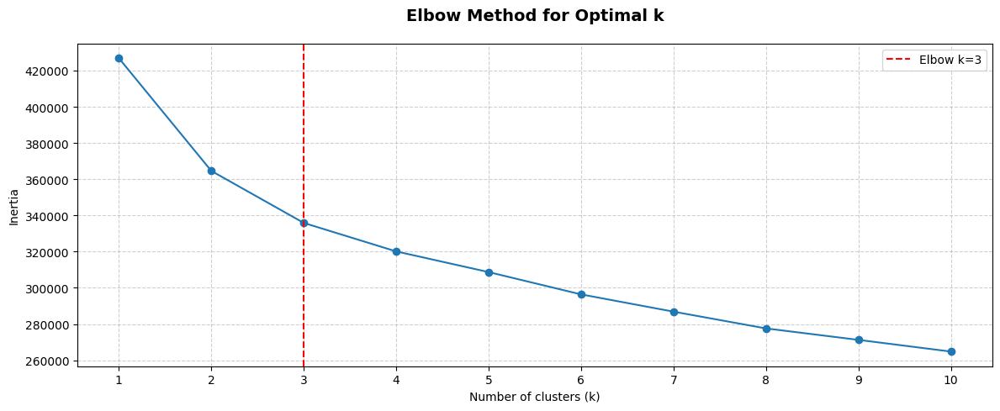

[✓] Optimal k suggested by Elbow: 3


In [140]:
# If X_prepared is sparse, convert to dense
X_use = X_prepared.toarray() if hasattr(X_prepared, "toarray") else X_prepared

# --- Elbow Method ---
inertia = []
K_elbow = range(1, 11)  # k = 1..10
for k in K_elbow:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init="auto")
    kmeans.fit(X_use)
    inertia.append(kmeans.inertia_)

# Find the elbow point
kneedle = KneeLocator(list(K_elbow), inertia, curve="convex", direction="decreasing")
k_best_elbow = kneedle.knee

# Plot Elbow
plt.figure(figsize=(12, 5))
plt.plot(list(K_elbow), inertia, marker="o", linestyle="-")
plt.xlabel("Number of clusters (k)")
plt.ylabel("Inertia")
plt.title("Elbow Method for Optimal k", fontsize=14, pad=20, weight="bold")
plt.grid(True, linestyle="--", alpha=0.6)
plt.xticks(range(1, 11))

# Mark elbow if found
if k_best_elbow is not None:
    plt.axvline(k_best_elbow, linestyle="--", label=f"Elbow k={k_best_elbow}", color = "red")
    plt.legend()

plt.tight_layout()
plt.show()

print(f"[✓] Optimal k suggested by Elbow: {k_best_elbow}")

In [141]:
# Fit K-means with the chosen number of clusters.
kmeans = KMeans(n_clusters=3, random_state=42, n_init="auto")
kmeans.fit(X_use)

# Assign clusters and calculate distance to cluster centroid
df_bank_transactions_kmean["Cluster"] = kmeans.labels_
df_bank_transactions_kmean["DistanceToCentroid"] = np.linalg.norm(X_use - kmeans.cluster_centers_[kmeans.labels_], axis=1)

# Identify potential frauds based on distance threshold
threshold = df_bank_transactions_kmean["DistanceToCentroid"].quantile(0.99)
df_bank_transactions_kmean["Potential_Fraud"] = df_bank_transactions_kmean["DistanceToCentroid"] > threshold

num_frauds = df_bank_transactions_kmean["Potential_Fraud"].sum()
print(f"[✓] Number of potential frauds detected: {num_frauds}")
display(df_bank_transactions_kmean[df_bank_transactions_kmean["Potential_Fraud"] == True].head().reset_index(drop=True))

[✓] Number of potential frauds detected: 500


,TransactionID,AccountID,TransactionAmount,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,Region,TransactionDate_epoch,Month,Cluster,DistanceToCentroid,Potential_Fraud
0,TX000275,AC00454,1176.28,Credit,Kansas City,D000476,50.202.8.53,M074,ATM,54,Engineer,174,5,323.69,Midwest,1703088480,12,0,3.961423,True
1,TX000395,AC00326,6.30,Debit,Columbus,D000539,210.160.90.52,M017,Branch,80,Retired,283,5,7697.68,Midwest,1702579920,12,0,3.916451,True
2,TX000557,AC00083,2.03,Credit,Detroit,D000271,112.86.148.212,M012,ATM,33,Engineer,28,1,3012.31,Midwest,1704125220,1,1,3.874175,True
3,TX000738,AC00149,1092.73,Debit,Columbus,D000688,56.89.80.133,M064,Branch,58,Retired,11,1,1390.98,Midwest,1674494640,1,1,3.669824,True
4,TX000935,AC00456,1022.75,Credit,San Jose,D000294,190.164.160.79,M091,Branch,62,Doctor,158,1,207.74,West,1674146700,1,1,3.639538,True


In [142]:
# Compute distances & flag potential frauds
# Distance of each point to its assigned cluster centroid
distances = np.linalg.norm(X_use - kmeans.cluster_centers_[kmeans.labels_], axis=1)

# Use the 99th percentile as anomaly threshold (top 1% farthest points)
threshold = np.quantile(distances, 0.99)
is_fraud = distances > threshold    # Boolean mask for potential fraud points


# Reduce to 2D using PCA for visual separation
pca = PCA(n_components=2, random_state=42)
X2 = pca.fit_transform(X_use)                        # PCA-transformed data
centroids2 = pca.transform(kmeans.cluster_centers_)  # PCA-transformed centroids


# Initialize Plotly figure
fig = go.Figure()

# Plot normal (non-fraud) points for each cluster
colors = ["#1B9E77", "#D95F02", "#7570B3"]    # Custom color palette for clusters

for c, color in enumerate(colors):
    # Points belonging to cluster c that are NOT flagged as fraud
    mask = (kmeans.labels_ == c) & (~is_fraud)

    fig.add_trace(go.Scatter(
        x=X2[mask, 0],
        y=X2[mask, 1],
        mode="markers",
        marker=dict(size=6, color=color, opacity=0.8),
        name=f"Cluster {c}"
    ))


# Plot potential frauds (highlighted red hollow markers) ---
fig.add_trace(go.Scatter(
    x=X2[is_fraud, 0],
    y=X2[is_fraud, 1],
    mode="markers",
    marker=dict(
        size=10,
        color="red",
        line=dict(width=1, color="black"),
        symbol="circle"
    ),
    name="Potential Frauds"
))


# Plot KMeans centroids (purple 'X' markers)
fig.add_trace(go.Scatter(
    x=centroids2[:, 0],
    y=centroids2[:, 1],
    mode="markers",
    marker=dict(size=14, color="purple", symbol="x"),
    name="Centroids"
))


# --- Layout and styling ---
fig.update_layout(
    title=dict(
        text="<b>KMeans Clusters (PCA 2D) with Potential Frauds</b>",
        font=dict(size=12, family="Segoe UI", color="white")
    ),
    xaxis_title="PCA Component 1",
    yaxis_title="PCA Component 2",
    legend=dict(
        orientation="h",
        font=dict(size=12, color="white", family="Segoe UI")
    ),
    template="plotly_dark",
    width=1800,
    height=600
)

# Axis styling
fig.update_xaxes(showgrid=True, title_font=dict(family="Segoe UI", size=12, color="white"))
fig.update_yaxes(showgrid=True, title_font=dict(family="Segoe UI", size=12, color="white"))

# Signature annotation
fig.add_annotation(
    text="Created By Thuan Dao.",
    xref="paper", yref="paper",
    x=1, y=-0.12,
    showarrow=False,
    font=dict(size=10, color="white", family="Segoe UI")
)

# Display chart
fig.show()

**K-Means Clustering Analysis Summary**

* **The K-Means model (k = 3)** forms three distinct behavioral clusters, well separated in PCA space.
* **500** transactions (≈ 1%) were flagged as potential frauds based on distance from cluster centroids.
* ✅ Overall, K-Means effectively captures transaction structure and isolates anomalous behaviors for fraud risk assessment.

In [143]:
def plot_cluster_features_plotly_slicer(df, month_col="Month"):
    """
    Multi-feature Plotly slicer for exploring customer clusters.
    
    For each cluster, this function visualizes:
    - Distribution of numerical features (Boxplots)
    - Distribution of categorical features (Bar charts)
    - Monthly trend of TransactionAmount (Line charts)
    - Comparison between Normal vs Fraud transactions
    
    A slicer (button menu) allows switching between clusters interactively.
    """

    cluster_ids = sorted(df["Cluster"].unique())
    colors = {"Normal": "#008FFB", "Fraud": "#FF4560"}

    # Create a 3x3 grid of subplots (total: 9 feature panels)
    fig = make_subplots(
        rows=3, cols=3,
        subplot_titles=[
            "<b>TransactionAmount Distribution</b>",
            "<b>Transaction Type Distribution</b>",
            "<b>Channel Distribution</b>",
            "<b>CustomerAge Distribution</b>",
            "<b>Customer Occupation Distribution</b>",
            "<b>Transaction Duration Distribution</b>",
            "<b>Account Balance Distribution</b>",
            "<b>Region Distribution</b>",
            "<b>Monthly Trend: Avg Transaction Amount</b>"
        ],
        horizontal_spacing=0.08,
        vertical_spacing=0.1
    )

    # Helper: Create all traces for a single cluster
    def make_traces_for_cluster(cluster_id, visible=True):
        cluster_data = df[df["Cluster"] == cluster_id]
        fraud_data = cluster_data[cluster_data["Potential_Fraud"] == True]
        normal_data = cluster_data[cluster_data["Potential_Fraud"] == False]

        vis = True if visible else False
        traces = []

        # 1) TransactionAmount (Boxplots)
        traces += [
            go.Box(y=normal_data["TransactionAmount"], name="Normal",
                   marker_color=colors["Normal"], visible=vis,
                   boxpoints="outliers", showlegend=True),
            go.Box(y=fraud_data["TransactionAmount"], name="Fraud",
                   marker_color=colors["Fraud"], visible=vis,
                   boxpoints="outliers", showlegend=True)
        ]

        # 2) TransactionType distribution
        order = df["TransactionType"].unique().tolist()
        for label, color, lblname in zip([False, True], [colors["Normal"], colors["Fraud"]], ["Normal", "Fraud"]):
            subset = cluster_data[cluster_data["Potential_Fraud"] == label]
            count = subset["TransactionType"].value_counts().reindex(order, fill_value=0)
            traces.append(
                go.Bar(x=count.index, y=count.values, name=lblname,
                       marker_color=color, visible=vis, showlegend=False)
            )

        # 3) Channel distribution
        order = df["Channel"].unique().tolist()
        for label, color, lblname in zip([False, True], [colors["Normal"], colors["Fraud"]], ["Normal", "Fraud"]):
            subset = cluster_data[cluster_data["Potential_Fraud"] == label]
            count = subset["Channel"].value_counts().reindex(order, fill_value=0)
            traces.append(
                go.Bar(x=count.index, y=count.values, name=lblname,
                       marker_color=color, visible=vis, showlegend=False)
            )

        # 4) CustomerAge (Boxplots)
        traces += [
            go.Box(y=normal_data["CustomerAge"], name="Normal",
                   marker_color=colors["Normal"], visible=vis, showlegend=False),
            go.Box(y=fraud_data["CustomerAge"], name="Fraud",
                   marker_color=colors["Fraud"], visible=vis, showlegend=False)
        ]

        # 5) CustomerOccupation distribution
        order = df["CustomerOccupation"].unique().tolist()
        for label, color, lblname in zip([False, True], [colors["Normal"], colors["Fraud"]], ["Normal", "Fraud"]):
            subset = cluster_data[cluster_data["Potential_Fraud"] == label]
            count = subset["CustomerOccupation"].value_counts().reindex(order, fill_value=0)
            traces.append(
                go.Bar(x=count.index, y=count.values, name=lblname,
                       marker_color=color, visible=vis, showlegend=False)
            )

        # 6) TransactionDuration (Boxplots)
        traces += [
            go.Box(y=normal_data["TransactionDuration"], name="Normal",
                   marker_color=colors["Normal"], visible=vis, showlegend=False),
            go.Box(y=fraud_data["TransactionDuration"], name="Fraud",
                   marker_color=colors["Fraud"], visible=vis, showlegend=False)
        ]

        # 7) AccountBalance (Boxplots)
        traces += [
            go.Box(y=normal_data["AccountBalance"], name="Normal",
                   marker_color=colors["Normal"], visible=vis, showlegend=False),
            go.Box(y=fraud_data["AccountBalance"], name="Fraud",
                   marker_color=colors["Fraud"], visible=vis, showlegend=False)
        ]

        # 8) Region distribution
        order = df["Region"].unique().tolist()
        for label, color, lblname in zip([False, True], [colors["Normal"], colors["Fraud"]], ["Normal", "Fraud"]):
            subset = cluster_data[cluster_data["Potential_Fraud"] == label]
            count = subset["Region"].value_counts().reindex(order, fill_value=0)
            traces.append(
                go.Bar(x=count.index, y=count.values, name=lblname,
                       marker_color=color, visible=vis, showlegend=False)
            )

        # 9) Monthly trend (Line charts)
        trend = cluster_data.groupby(month_col)["TransactionAmount"].mean().reset_index()
        fraud_trend = fraud_data.groupby(month_col)["TransactionAmount"].mean().reset_index()

        traces += [
            go.Scatter(x=trend[month_col], y=trend["TransactionAmount"],
                       mode="lines+markers", name="Avg Normal Transactions",
                       line=dict(color="blue", width=2), visible=vis),

            go.Scatter(x=fraud_trend[month_col], y=fraud_trend["TransactionAmount"],
                       mode="lines+markers", name="Avg Fraud Transactions",
                       line=dict(color="red", width=2), fill="tonexty",
                       fillcolor="rgba(255,0,0,0.15)", visible=vis)
        ]

        return traces

    # Generate all traces for all clusters
    all_traces = []
    for i, cid in enumerate(cluster_ids):
        traces = make_traces_for_cluster(cid, visible=(i == 0))  # Only first cluster visible by default
        all_traces.extend(traces)

    # Map traces onto each subplot (pair of traces per subplot)
    subplot_positions = [(r, c) for r in range(1, 4) for c in range(1, 4)]
    cluster_traces_per_chart = len(all_traces) // len(cluster_ids)  # number of traces for single cluster

    for i, trace in enumerate(all_traces):
        pos = subplot_positions[(i // 2) % 9]  # each pair goes into same subplot
        fig.add_trace(trace, row=pos[0], col=pos[1])

    # Create slicer buttons (for each cluster)
    buttons = []
    for i, cid in enumerate(cluster_ids):
        visible = [False] * len(all_traces)

        # Activate only traces belonging to this cluster
        start = i * cluster_traces_per_chart
        end = (i + 1) * cluster_traces_per_chart
        for j in range(start, end):
            visible[j] = True

        buttons.append(dict(
            label=f"Cluster {cid}",
            method="update",
            args=[
                {"visible": visible},
                {"title": f"<b>Cluster {cid}: Fraud Behavior across Multiple Features and Monthly Trend</b>"}
            ]
        ))

    # Layout styling and configuration
    fig.update_annotations(font=dict(family="Segoe UI", size=12, color="white"))

    fig.update_layout(
        updatemenus=[dict(
            type="buttons",
            direction="left",
            buttons=buttons,
            x=1, xanchor="center",
            y=1.12, yanchor="top",
            showactive=True,
            bgcolor="#4B0082",
            borderwidth=0,
            font=dict(size=12, color="black")
        )],
        height=1300,
        width=1800,
        title=dict(
            text=f"<b>Cluster {cluster_ids[0]}: Fraud Behavior across Multiple Features and Monthly Trend</b>",
            font=dict(size=12, family="Segoe UI", color="white")
        ),
        template="plotly_dark",
        legend=dict(
            orientation="h",
            y=-0.05, x=0.5, xanchor="center",
            font=dict(size=12, color="white", family="Segoe UI")
        ),
        hovermode="x unified"
    )

    fig.update_xaxes(showgrid=False, title_font=dict(family="Segoe UI", size=12, color="white"))
    fig.update_yaxes(showgrid=False, title_font=dict(family="Segoe UI", size=12, color="white"))

    # Signature
    fig.add_annotation(
        text="Created By Thuan Dao.",
        xref="paper", yref="paper",
        x=1, y=-0.05,
        showarrow=False,
        font=dict(size=10, color="white", family="Segoe UI")
    )

    fig.show()

plot_cluster_features_plotly_slicer(df=df_bank_transactions_kmean)

**Cluster 0 – Fraud Behavior Overview**

* Fraudulent transactions show **higher amount** and **longer duration**.
* Within fraud: **Debit ≈ 85.5%**; channels **Branch > ATM > Online**.
* **Older users** dominate; **Doctors, Retired and Engineers** appear more frequently among frauds.
* **Higher account balances** linked with frauds.
* Regional share: mainly in **West and Midwest**.
* Monthly trends show **strong volatility**, indicating episodic fraud spikes rather than stable patterns.

**Cluster 1 – Fraud Behavior Overview**

* Fraud = **higher transaction amount** and **longer duration** again.
* Within fraud: **Debit ≈ 69%**, **Branch > ATM > Online**.
* **Older users** dominate; **Doctors, Retired and Engineers** appear more frequently among frauds.
* **Higher account balances** linked with frauds.
* Regional pattern: stronger concentration in **Midwest and West**.
* Monthly trends show **strong volatility**, indicating episodic fraud spikes rather than stable patterns.

**Cluster 2 – Fraud Behavior Overview**

* Fraud transactions = **high-value and longer-duration** patterns.
* Within fraud: **Debit ≈ 56.67%**, and **Online > ATM > Branch** usage.
* **Older users** dominate, especially **Student**.
* **Higher account balances** than both Cluster 0 and 1.
* Regionally focused in **West and South**.
* Monthly trends show **strong volatility**, indicating episodic fraud spikes rather than stable patterns.

In [144]:
def world_map_transaction(df, cluster_id):
    """
    Generate an interactive world map showing fraud transactions of a specific cluster.
    - Uses Folium to plot coordinated points.
    - Automatically geocodes text-based location names.
    - Creates rich HTML tooltips containing transaction details.
    - Saves the output map as an HTML file.

    Parameters:
    -----------
    df : pandas.DataFrame  
        Input dataframe containing transaction, cluster, and fraud information.

    cluster_id : int  
        The target cluster to visualize on the world map.

    Returns:
    --------
    folium.Map  
        The generated interactive map object.
    """

    import folium
    from geopy.geocoders import Nominatim
    from geopy.extra.rate_limiter import RateLimiter

    # Work on a copy to avoid modifying original DataFrame
    df_bank_transactions_wm = df.copy()

    # Filter: Only fraud transactions belonging to the selected cluster
    fraud_data_cluster = df_bank_transactions_wm[
        (df_bank_transactions_wm["Cluster"] == cluster_id)
        & (df_bank_transactions_wm["Potential_Fraud"] == True)
    ].copy()

    # List of unique location names (e.g., cities)
    unique_locations = fraud_data_cluster["Location"].unique()
    location_coords = {}

    # Initialize geocoder with rate limiting to avoid API blocking
    geolocator = Nominatim(user_agent="location_mapper")
    geocode = RateLimiter(
        geolocator.geocode,
        min_delay_seconds=1,
        max_retries=3,
        error_wait_seconds=3,
        swallow_exceptions=False
    )

    print(f"[*] Fetching coordinates for {len(unique_locations)} unique locations...")

    # Loop through and geocode each unique location
    for location in unique_locations:
        try:
            loc = geocode(location, timeout=15)
            if loc:
                location_coords[location] = (loc.latitude, loc.longitude)
            else:
                print(f"[!] Coordinates not found for {location}")
        except Exception as e:
            print(f"[x] Error fetching coordinates for {location}: {e}")

    # Map coordinates back to each fraud row
    fraud_data_cluster["Location"] = fraud_data_cluster["Location"].astype(str)
    fraud_data_cluster["Coordinates"] = fraud_data_cluster["Location"].map(location_coords)

    # Keep only rows with valid coordinates
    fraud_data_cluster = fraud_data_cluster[
        fraud_data_cluster["Coordinates"].apply(lambda x: isinstance(x, (list, tuple)) and len(x) == 2)
    ]

    # Determine the initial map center
    if len(location_coords) > 0:
        initial_coords = list(location_coords.values())[0]
    else:
        print("[!] No coordinates found — initializing map at (0,0)")
        initial_coords = [0, 0]

    # Initialize Folium map (dark themed)
    mymap = folium.Map(location=initial_coords, zoom_start=5, tiles="CartoDB dark_matter")

    # Add markers for each fraud transaction
    for _, row in fraud_data_cluster.iterrows():
        coords = row["Coordinates"]

        # Rich HTML tooltip panel
        tooltip_html = f"""
        <div style='font-size:13px; line-height:1.5'>
            <b>TransactionID:</b> {row['TransactionID']}<br>
            <b>Amount:</b> ${row['TransactionAmount']}<br>
            <b>AccountID:</b> {row['AccountID']}<br>
            <b>Age:</b> {row['CustomerAge']}<br>
            <b>City:</b> {row['Location']}<br>
            <b>TransactionType:</b> {row['TransactionType']}<br>
            <b>Channel:</b> {row['Channel']}<br>
            <b>CustomerOccupation:</b> {row['CustomerOccupation']}<br>
            <b>TransactionDuration:</b> {row['TransactionDuration']}<br>
        </div>
        """

        # Add marker to map
        folium.Marker(
            location=coords,
            tooltip=folium.Tooltip(tooltip_html, sticky=True),
            icon=folium.Icon(color="lightgray", icon="info-sign")
        ).add_to(mymap)

    # Save the map to an HTML file
    map_path = f"./saved-map-Kmeans-cluster-{cluster_id}.html"
    mymap.save(map_path)
    print(f"[✓] Map saved successfully: {map_path}")

    return mymap

In [145]:
world_map_transaction(df=df_bank_transactions_kmean, cluster_id=0)

[*] Fetching coordinates for 29 unique locations...
[✓] Map saved successfully: ./saved-map-Kmeans-cluster-0.html


In [146]:
world_map_transaction(df=df_bank_transactions_kmean, cluster_id=1)

[*] Fetching coordinates for 32 unique locations...
[✓] Map saved successfully: ./saved-map-Kmeans-cluster-1.html


In [147]:
world_map_transaction(df=df_bank_transactions_kmean, cluster_id=2)

[*] Fetching coordinates for 21 unique locations...
[✓] Map saved successfully: ./saved-map-Kmeans-cluster-2.html


In [148]:
def world_map_transaction_v2(df, feature_Potential_Fraud, model_name="DBSCAN"):
    """
    Create an interactive world map visualizing fraud transactions detected by a clustering model.
    - Fraud points are identified by label = -1 (common for DBSCAN).
    - Coordinates for each unique city are fetched via geopy.
    - Outputs an HTML file containing a Folium world map.

    Parameters:
    -----------
    df : pandas.DataFrame
        Input dataframe containing transactions, locations, and fraud labels.

    feature_Potential_Fraud : str
        Name of the column indicating anomaly classification (e.g., -1 = fraud from DBSCAN).

    model_name : str, default="DBSCAN"
        Name of the model (used when saving the output HTML file).

    Returns:
    --------
    folium.Map
        Interactive Folium map object.
    """

    df_bank_transactions_wm = df.copy()

    # Select only fraud/anomaly records based on the model's label
    fraud_data_cluster = df_bank_transactions_wm[
        df_bank_transactions_wm[feature_Potential_Fraud] == -1
    ].copy()

    # Extract unique city names to geocode
    unique_locations = fraud_data_cluster["Location"].unique()
    location_coords = {}

    # Initialize geocoder with rate limiting to avoid API blocking
    geolocator = Nominatim(user_agent="location_mapper")
    geocode = RateLimiter(
        geolocator.geocode,
        min_delay_seconds=1,
        max_retries=3,
        error_wait_seconds=3,
        swallow_exceptions=False
    )

    print(f"[*] Fetching coordinates for {len(unique_locations)} unique locations...")

    # Fetch coordinates for each unique location
    for location in unique_locations:
        try:
            loc = geocode(location, timeout=15)
            if loc:
                location_coords[location] = (loc.latitude, loc.longitude)
            else:
                print(f"[!] Coordinates not found for {location}")
        except Exception as e:
            print(f"[x] Error fetching coordinates for {location}: {e}")

    # Map coordinates back to each fraud record
    fraud_data_cluster["Location"] = fraud_data_cluster["Location"].astype(str)
    fraud_data_cluster["Coordinates"] = fraud_data_cluster["Location"].map(location_coords)

    # Keep only valid coordinate entries
    fraud_data_cluster = fraud_data_cluster[
        fraud_data_cluster["Coordinates"].apply(lambda x: isinstance(x, (list, tuple)) and len(x) == 2)
    ]

    # Determine initial map center point
    if len(location_coords) > 0:
        initial_coords = list(location_coords.values())[0]
    else:
        print("[!] No coordinates found — initializing map at (0,0)")
        initial_coords = [0, 0]

    # Create dark-themed Folium map
    mymap = folium.Map(location=initial_coords, zoom_start=5, tiles="CartoDB dark_matter")

    # Add markers for each fraud transaction
    for _, row in fraud_data_cluster.iterrows():
        coords = row["Coordinates"]

        tooltip_html = f"""
        <div style='font-size:13px; line-height:1.5'>
            <b>TransactionID:</b> {row['TransactionID']}<br>
            <b>Amount:</b> ${row['TransactionAmount']}<br>
            <b>AccountID:</b> {row['AccountID']}<br>
            <b>Age:</b> {row['CustomerAge']}<br>
            <b>City:</b> {row['Location']}<br>
            <b>TransactionType:</b> {row['TransactionType']}<br>
            <b>Channel:</b> {row['Channel']}<br>
            <b>CustomerOccupation:</b> {row['CustomerOccupation']}<br>
            <b>TransactionDuration:</b> {row['TransactionDuration']}<br>
        </div>
        """

        folium.Marker(
            location=coords,
            tooltip=folium.Tooltip(tooltip_html, sticky=True),
            icon=folium.Icon(color="lightgray", icon="info-sign")
        ).add_to(mymap)

    # Save output map as HTML file
    map_path = f"./saved-map-{model_name}.html"
    mymap.save(map_path)
    print(f"[✓] Map saved successfully: {map_path}")

    return mymap

## Isolation Forest

In [149]:
# Define outlier mapping
outlier_mapping = {1: "Normal", -1: "Potential Fraud"}

# Fit the Isolation Forest model
iso_forest = IsolationForest(n_estimators=100, contamination=0.01, random_state=42)
iso_forest.fit(X_use)

# Predict anomalies
df_bank_transactions_isolation["AnomalyScore"] = iso_forest.decision_function(X_use)
df_bank_transactions_isolation["IsAnomaly"] = iso_forest.predict(X_use)

# Map results to descriptive labels
df_bank_transactions_isolation["AnomalyLabel"] = df_bank_transactions_isolation["IsAnomaly"].map(outlier_mapping)
cols = ["TransactionID", "AccountID", "IsAnomaly", "AnomalyLabel"]
isolation_output = df_bank_transactions_isolation[cols]
isolation_output.to_csv("isolation_output.csv", index=False)

# Filter out detected anomalies
potential_frauds = df_bank_transactions_isolation[df_bank_transactions_isolation["IsAnomaly"] == -1]
print(f"[✓] Number of potential frauds detected: {len(potential_frauds)}")
display(potential_frauds.reset_index(drop=True).head())

[✓] Number of potential frauds detected: 500


,TransactionID,AccountID,TransactionAmount,TransactionType,Location,DeviceID,IP Address,MerchantID,Channel,CustomerAge,CustomerOccupation,TransactionDuration,LoginAttempts,AccountBalance,Region,TransactionDate_epoch,Month,AnomalyScore,IsAnomaly,AnomalyLabel
0,TX000118,AC00498,56.98,Credit,Oklahoma City,D000256,101.90.40.193,M086,ATM,43,Engineer,122,2,5688.37,South,1704126840,1,-0.003474,-1,Potential Fraud
1,TX000148,AC00161,514.95,Debit,New York,D000109,23.92.205.75,M056,Online,41,Doctor,142,5,421.93,Northeast,1681411020,4,-0.000138,-1,Potential Fraud
2,TX000267,AC00178,66.90,Credit,Charlotte,D000221,138.210.196.19,M021,Online,79,Retired,129,4,5238.71,South,1681750200,4,-0.001578,-1,Potential Fraud
3,TX000275,AC00454,1176.28,Credit,Kansas City,D000476,50.202.8.53,M074,ATM,54,Engineer,174,5,323.69,Midwest,1703088480,12,-0.037939,-1,Potential Fraud
4,TX000284,AC00387,362.04,Credit,Philadelphia,D000145,52.1.78.30,M059,Branch,58,Doctor,198,2,8421.88,Northeast,1689007020,7,-0.021610,-1,Potential Fraud


In [150]:
# === PCA reduction ===
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_use)

viz_df = df_bank_transactions_isolation.copy()
viz_df["PCA1_Isolation"] = X_pca[:, 0]
viz_df["PCA2_Isolation"] = X_pca[:, 1]

threshold = 0  # IsolationForest decision boundary
normal_df = viz_df[viz_df["IsAnomaly"] == 1]
anomaly_df = viz_df[viz_df["IsAnomaly"] == -1]

# === Create subplot layout (1 row, 2 columns) ===
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=(
        "<b>Isolation Forest — Potential Frauds vs Normal (PCA 2D)</b>",
        "<b>Distribution of Isolation Forest Anomaly Scores</b>"
    ),
    horizontal_spacing=0.15
)

# --- Left subplot: PCA scatter ---
fig.add_trace(
    go.Scatter(
        x=normal_df["PCA1_Isolation"],
        y=normal_df["PCA2_Isolation"],
        mode="markers",
        marker=dict(size=5, color="#A0A0A0", opacity=0.55),
        name=f"Normal (n={len(normal_df)})"
    ),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(
        x=anomaly_df["PCA1_Isolation"],
        y=anomaly_df["PCA2_Isolation"],
        mode="markers",
        marker=dict(size=7, color="red", opacity=0.8,
                    line=dict(color="black", width=0.4)),
        name=f"Potential Fraud (n={len(anomaly_df)})"
    ),
    row=1, col=1
)

# --- Right subplot: Histogram of anomaly scores ---
fig.add_trace(
    go.Histogram(
        x=viz_df["AnomalyScore"],
        nbinsx=60,
        marker=dict(color="#4682B4", line=dict(color="white", width=0.5)),
        opacity=0.85,
        name="Anomaly Score Distribution"
    ),
    row=1, col=2
)

# --- Threshold line ---
y_max = np.histogram(viz_df["AnomalyScore"], bins=60)[0].max()

fig.add_trace(
    go.Scatter(
        x=[threshold, threshold],
        y=[0, y_max],
        mode="lines",
        line=dict(color="red", dash="dash", width=2),
        name=f"Threshold = {threshold:.3f}"
    ),
    row=1, col=2
)

# --- Anomaly zone (left) and Normal zone (right) ---
fig.add_vrect(
    x0=viz_df["AnomalyScore"].min(),
    x1=threshold,
    fillcolor="red",
    opacity=0.1,
    layer="below",
    line_width=0,
    row=1, col=2
)
fig.add_vrect(
    x0=threshold,
    x1=viz_df["AnomalyScore"].max(),
    fillcolor="green",
    opacity=0.08,
    layer="below",
    line_width=0,
    row=1, col=2
)

# --- Add text annotations for zones ---
fig.add_annotation(
    x=threshold - 0.01,
    y=y_max * 0.9,
    text="← Anomaly zone",
    showarrow=False,
    font=dict(color="red", size=12),
    xanchor="right",
    row=1, col=2
)
fig.add_annotation(
    x=threshold + 0.01,
    y=y_max * 0.9,
    text="Normal zone →",
    showarrow=False,
    font=dict(color="green", size=12),
    xanchor="left",
    row=1, col=2
)

# === Layout & formatting ===
fig.update_xaxes(title_text="PCA Component 1", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=1)
fig.update_yaxes(title_text="PCA Component 2", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=1)
fig.update_xaxes(title_text="Anomaly Score", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=2)
fig.update_yaxes(title_text="Frequency", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=2)
fig.update_annotations(font=dict(family="Segoe UI", size=12, color="white"))
fig.update_layout(
    title = dict(text="<b>Isolation Forest — Fraud Detection Visualization</b>",
                 font=dict(size=12, family="Segoe UI", color="white")),
    template="plotly_dark",
    legend=dict(orientation="h", font=dict(size=12, color="white", family="Segoe UI")),
    width=1800,
    height=600
)
fig.add_annotation(
    text="Created By Thuan Dao.",
    xref="paper", yref="paper",
    x=1, y=-0.12,
    showarrow=False,
    font=dict(size=10, color="white", family="Segoe UI")
)

fig.show()

**Isolation Forest — Overall Fraud Detection Summary**

**Cluster Visualization (Left Chart)**

* The PCA scatter plot shows a **clear separation** between normal transactions (gray) and potential frauds (red).
* This visual confirms that the algorithm effectively distinguishes **outlier behaviors** without requiring explicit labels.

**Anomaly Score Distribution (Right Chart)**

* The histogram of anomaly scores reveals a **left-skewed distribution**, where most transactions cluster in the **normal (positive score)** zone.
* The **vertical red dashed line at 0** represents the model’s automatic **decision boundary**:

  * **Left side (< 0):** “Anomaly zone” — likely fraudulent or suspicious.
  * **Right side (≥ 0):** “Normal zone” — legitimate transactions.
* The clear drop near the threshold suggests the **model separates normal and abnormal behavior well**.

**Key Insight**
Isolation Forest successfully identifies a small subset of transactions (≈5%) as anomalies.
These are **behaviorally distinct and statistically isolated**, warranting further investigation for potential fraud or system irregularities.

In [151]:
def plot_cluster_features_isolation_forest_plotly(df, month_col="Month"):
    # --- Separate normal and fraud ---
    normal_data = df[df["IsAnomaly"] == 1].copy()
    fraud_data = df[df["IsAnomaly"] == -1].copy()

    # --- Define colors ---
    colors = {"Normal": "#008FFB", "Fraud": "#FF4560"}

    # --- Create 3x3 grid ---
    fig = make_subplots(
        rows=3, cols=3,
        subplot_titles=[
            "<b>TransactionAmount Distribution</b>",
            "<b>Transaction Type Distribution</b>",
            "<b>Channel Distribution</b>",
            "<b>CustomerAge Distribution</b>",
            "<b>Customer Occupation Distribution</b>",
            "<b>Transaction Duration Distribution</b>",
            "<b>Account Balance Distribution</b>",
            "<b>Region Distribution</b>",
            "<b>Monthly Trend: Avg Transaction Amount</b>"
        ],
        horizontal_spacing=0.08,
        vertical_spacing=0.1
    )

    # TransactionAmount (Boxplot)
    fig.add_trace(
        go.Box(y=normal_data["TransactionAmount"], name="Normal", marker_color=colors["Normal"], boxpoints="outliers"),
        row=1, col=1
    )
    fig.add_trace(
        go.Box(y=fraud_data["TransactionAmount"], name="Fraud", marker_color=colors["Fraud"], boxpoints="outliers"),
        row=1, col=1
    )

    # TransactionType (Bar)
    order = df["TransactionType"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["TransactionType"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=1, col=2)

    # Channel (Bar)
    order = df["Channel"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["Channel"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=1, col=3)

    # CustomerAge (Box)
    fig.add_trace(go.Box(y=normal_data["CustomerAge"], name="Normal", marker_color=colors["Normal"], showlegend=False), row=2, col=1)
    fig.add_trace(go.Box(y=fraud_data["CustomerAge"], name="Fraud", marker_color=colors["Fraud"], showlegend=False), row=2, col=1)

    # CustomerOccupation (Bar)
    order = df["CustomerOccupation"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["CustomerOccupation"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=2, col=2)

    # TransactionDuration (Box)
    fig.add_trace(go.Box(y=normal_data["TransactionDuration"], name="Normal", marker_color=colors["Normal"], showlegend=False), row=2, col=3)
    fig.add_trace(go.Box(y=fraud_data["TransactionDuration"], name="Fraud", marker_color=colors["Fraud"], showlegend=False), row=2, col=3)

    # AccountBalance (Box)
    fig.add_trace(go.Box(y=normal_data["AccountBalance"], name="Normal", marker_color=colors["Normal"], showlegend=False), row=3, col=1)
    fig.add_trace(go.Box(y=fraud_data["AccountBalance"], name="Fraud", marker_color=colors["Fraud"], showlegend=False), row=3, col=1)

    # Region (Bar)
    order = df["Region"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["Region"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=3, col=2)

    # Monthly trend
    trend = normal_data.groupby(month_col)["TransactionAmount"].mean().reset_index()
    fraud_trend = fraud_data.groupby(month_col)["TransactionAmount"].mean().reset_index()
    fig.update_annotations(font=dict(family="Segoe UI", size=12, color="white"))
    fig.add_trace(go.Scatter(
        x=trend[month_col], y=trend["TransactionAmount"],
        mode="lines+markers", name="Avg Normal Transactions",
        line=dict(color=colors["Normal"], width=2)
    ), row=3, col=3)

    fig.add_trace(go.Scatter(
        x=fraud_trend[month_col], y=fraud_trend["TransactionAmount"],
        mode="lines+markers", name="Avg Fraud Transactions",
        line=dict(color=colors["Fraud"], width=2),
        fill="tonexty", fillcolor="rgba(255,0,0,0.15)"
    ), row=3, col=3)

    # Layout customization
    fig.update_layout(
        height=1300, width=1800,
        title=dict(
            text="<b>Fraud Behavior across Multiple Features and Monthly Trend (Isolation Forest)</b>",
            font=dict(size=12, family="Segoe UI", color="white")
        ),
        template="plotly_dark",
        legend=dict(orientation="h",font=dict(size=12, color="white", family="Segoe UI")),
        hovermode="x unified"
    )

    # Remove gridlines for clean look
    fig.update_xaxes(showgrid=False, title_font=dict(size=12, color="white", family="Segoe UI"))
    fig.update_yaxes(showgrid=False, title_font=dict(size=12, color="white", family="Segoe UI"))
    fig.add_annotation(
        text="Created By Thuan Dao.",
        xref="paper", yref="paper",
        x=1, y=-0.1,
        showarrow=False,
        font=dict(size=10, color="white", family="Segoe UI")
    )
    fig.show()

plot_cluster_features_isolation_forest_plotly(df_bank_transactions_isolation)

**Fraud Behavior Summary (Isolation Forest Results)**

* **Fraud tends to involve smaller amounts but longer transaction duration.**
* **Fraud occurs more frequently in Credit transactions and in Branch/Online channels.**
* **Fraud is more common among older customers, with no strong occupation differences, though Retired is slightly higher.**
* **Fraudulent accounts generally have lower balances than normal accounts.**
* **Regional differences are minimal, with no clear separation.**
* **Monthly trends are highly volatile, indicating periodic fraud spikes rather than steady behavior.**

In [152]:
world_map_transaction_v2(df=df_bank_transactions_isolation, feature_Potential_Fraud="IsAnomaly", model_name="Isolation")

[*] Fetching coordinates for 28 unique locations...
[✓] Map saved successfully: ./saved-map-Isolation.html


## LocalOutlierFactor

In [153]:
# === Train LOF ===
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.01)
y_pred = lof.fit_predict(X_use)  # -1 = anomaly, 1 = normal
lof_scores = -lof.negative_outlier_factor_

# === Prepare dataframe ===
viz_df = df_bank_transactions_lof.copy()
viz_df["LOF_Score"] = lof_scores
viz_df["LOF_Label"] = y_pred

# PCA for visualization
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_use)
viz_df["PCA1_LOF"] = X_pca[:, 0]
viz_df["PCA2_LOF"] = X_pca[:, 1]

# Split
normal_df = viz_df[viz_df["LOF_Label"] == 1]
anomaly_df = viz_df[viz_df["LOF_Label"] == -1]
print(f"[✓] Number of potential frauds detected: {len(anomaly_df)}")

# === Determine threshold by Knee point ===
sorted_scores = np.sort(viz_df["LOF_Score"].values)
x = np.arange(len(sorted_scores))
kneedle = KneeLocator(x, sorted_scores, curve="convex", direction="increasing")
threshold = sorted_scores[kneedle.knee]
print(f"[✓] Knee point threshold: {threshold:.4f}")

# === Create subplot layout (1x2) ===
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=[
        "<b>Local Outlier Factor — Potential Frauds vs Normal (PCA 2D)</b>",
        "<b>Distribution of LOF Anomaly Scores</b>"
    ],
    horizontal_spacing=0.15
)

# --- (1) PCA scatter plot ---
fig.add_trace(
    go.Scatter(
        x=normal_df["PCA1_LOF"],
        y=normal_df["PCA2_LOF"],
        mode="markers",
        name=f"Normal (n={len(normal_df)})",
        marker=dict(size=5, color="#A0A0A0", opacity=0.55)
    ),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(
        x=anomaly_df["PCA1_LOF"],
        y=anomaly_df["PCA2_LOF"],
        mode="markers",
        name=f"Potential Fraud (n={len(anomaly_df)})",
        marker=dict(size=7, color="red", opacity=0.8,
                    line=dict(color="black", width=0.5))
    ),
    row=1, col=1
)

# --- (2) LOF score histogram ---
fig.add_trace(
    go.Histogram(
        x=viz_df["LOF_Score"],
        nbinsx=60,
        marker=dict(color="#4682B4", line=dict(color="white", width=0.5)),
        opacity=0.85,
        name="LOF Score Distribution"
    ),
    row=1, col=2
)

# --- Add threshold line ---
y_max = np.histogram(viz_df["LOF_Score"], bins=60)[0].max()
fig.add_trace(
    go.Scatter(
        x=[threshold, threshold],
        y=[0, y_max],
        mode="lines",
        line=dict(color="red", dash="dash", width=2),
        name=f"Threshold = {threshold:.3f}"
    ),
    row=1, col=2
)

# --- Add shaded regions ---
fig.add_vrect(
    x0=viz_df["LOF_Score"].min(), x1=threshold,
    fillcolor="green", opacity=0.08, layer="below", line_width=0,
    row=1, col=2
)
fig.add_vrect(
    x0=threshold, x1=viz_df["LOF_Score"].max(),
    fillcolor="red", opacity=0.08, layer="below", line_width=0,
    row=1, col=2
)

# --- Add text annotations ---
fig.add_annotation(
    x=threshold - 0.01, y=y_max * 0.9,
    text="← Normal zone",
    showarrow=False, font=dict(color="green", size=12),
    xanchor="right", row=1, col=2
)
fig.add_annotation(
    x=threshold + 0.01, y=y_max * 0.9,
    text="Anomaly zone →",
    showarrow=False, font=dict(color="red", size=12),
    xanchor="left", row=1, col=2
)

# === Axes titles & layout ===
fig.update_xaxes(title_text="PCA Component 1", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=1)
fig.update_yaxes(title_text="PCA Component 2", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=1)
fig.update_xaxes(title_text="LOF Score (higher = more anomalous)", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=2)
fig.update_yaxes(title_text="Frequency", title_font=dict(size=12, color="white", family="Segoe UI"), row=1, col=2)
fig.update_annotations(font=dict(family="Segoe UI", size=12, color="white"))
fig.update_layout(
    title = dict(text="<b>Local Outlier Factor — Fraud Detection Visualization</b>",
                 font=dict(size=12, family="Segoe UI", color="white")),
    template="plotly_dark",
    legend=dict(orientation="h", font=dict(size=12, color="white", family="Segoe UI")),
    width=1800,
    height=600
)

fig.show()

[✓] Number of potential frauds detected: 500
[✓] Knee point threshold: 1.2860


**LOF Model – Overview Insight**

* Clear visual separation between **normal (gray)** and potential **fraud (red)** transactions.
* The histogram shows a **right-skewed distribution** with most transactions below the anomaly threshold (LOF = 1.092).
* LOF identifies about **1% of transactions** as potential frauds, effectively isolating **low-density, irregular behaviors** that deviate from normal transaction patterns.

In [154]:
viz_df["LOF_Description"] = viz_df["LOF_Label"].map({
    -1: "Potential Fraud",
     1: "Normal"
})

def plot_cluster_features_local_outlier(df=viz_df, month_col="Month"):
    # --- Separate normal and fraud ---
    normal_data = df[df["LOF_Description"] == "Normal"].copy()
    fraud_data = df[df["LOF_Description"] == "Potential Fraud"].copy()

    # --- Define colors ---
    colors = {"Normal": "#008FFB", "Fraud": "#FF4560"}

    # --- Create 3x3 grid ---
    fig = make_subplots(
        rows=3, cols=3,
        subplot_titles=[
            "<b>TransactionAmount Distribution</b>",
            "<b>Transaction Type Distribution</b>",
            "<b>Channel Distribution</b>",
            "<b>CustomerAge Distribution</b>",
            "<b>Customer Occupation Distribution</b>",
            "<b>Transaction Duration Distribution</b>",
            "<b>Account Balance Distribution</b>",
            "<b>Region Distribution</b>",
            "<b>Monthly Trend: Avg Transaction Amount</b>"
        ],
        horizontal_spacing=0.08,
        vertical_spacing=0.1
    )

    # TransactionAmount (Boxplot)
    fig.add_trace(
        go.Box(y=normal_data["TransactionAmount"], name="Normal", marker_color=colors["Normal"], boxpoints="outliers"),
        row=1, col=1
    )
    fig.add_trace(
        go.Box(y=fraud_data["TransactionAmount"], name="Fraud", marker_color=colors["Fraud"], boxpoints="outliers"),
        row=1, col=1
    )

    # TransactionType (Bar)
    order = df["TransactionType"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["TransactionType"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=1, col=2)

    # Channel (Bar)
    order = df["Channel"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["Channel"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=1, col=3)

    # CustomerAge (Box)
    fig.add_trace(go.Box(y=normal_data["CustomerAge"], name="Normal", marker_color=colors["Normal"], showlegend=False), row=2, col=1)
    fig.add_trace(go.Box(y=fraud_data["CustomerAge"], name="Fraud", marker_color=colors["Fraud"], showlegend=False), row=2, col=1)

    # CustomerOccupation (Bar)
    order = df["CustomerOccupation"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["CustomerOccupation"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=2, col=2)

    # TransactionDuration (Box)
    fig.add_trace(go.Box(y=normal_data["TransactionDuration"], name="Normal", marker_color=colors["Normal"], showlegend=False), row=2, col=3)
    fig.add_trace(go.Box(y=fraud_data["TransactionDuration"], name="Fraud", marker_color=colors["Fraud"], showlegend=False), row=2, col=3)

    # AccountBalance (Box)
    fig.add_trace(go.Box(y=normal_data["AccountBalance"], name="Normal", marker_color=colors["Normal"], showlegend=False), row=3, col=1)
    fig.add_trace(go.Box(y=fraud_data["AccountBalance"], name="Fraud", marker_color=colors["Fraud"], showlegend=False), row=3, col=1)

    # Region (Bar)
    order = df["Region"].unique().tolist()
    for label, subset, color in zip(["Normal", "Fraud"], [normal_data, fraud_data], [colors["Normal"], colors["Fraud"]]):
        count = subset["Region"].value_counts().reindex(order, fill_value=0)
        fig.add_trace(go.Bar(x=count.index, y=count.values, name=label, marker_color=color, showlegend=False), row=3, col=2)

    # Monthly trend
    trend = normal_data.groupby(month_col)["TransactionAmount"].mean().reset_index()
    fraud_trend = fraud_data.groupby(month_col)["TransactionAmount"].mean().reset_index()
    fig.update_annotations(font=dict(family="Segoe UI", size=12, color="white"))
    fig.add_trace(go.Scatter(
        x=trend[month_col], y=trend["TransactionAmount"],
        mode="lines+markers", name="Avg Normal Transactions",
        line=dict(color=colors["Normal"], width=2)
    ), row=3, col=3)

    fig.add_trace(go.Scatter(
        x=fraud_trend[month_col], y=fraud_trend["TransactionAmount"],
        mode="lines+markers", name="Avg Fraud Transactions",
        line=dict(color=colors["Fraud"], width=2),
        fill="tonexty", fillcolor="rgba(255,0,0,0.15)"
    ), row=3, col=3)

    # Layout customization
    fig.update_layout(
        height=1300, width=1800,
        title=dict(
            text="<b>Fraud Behavior across Multiple Features and Monthly Trend (Local Outlier Factor)</b>",
            font=dict(size=12, family="Segoe UI", color="white")
        ),
        template="plotly_dark",
        legend=dict(orientation="h",font=dict(size=12, color="white", family="Segoe UI")),
        hovermode="x unified"
    )

    # Remove gridlines for clean look
    fig.update_xaxes(showgrid=False, title_font=dict(size=12, color="white", family="Segoe UI"))
    fig.update_yaxes(showgrid=False, title_font=dict(size=12, color="white", family="Segoe UI"))
    fig.add_annotation(
        text="Created By Thuan Dao.",
        xref="paper", yref="paper",
        x=1, y=-0.1,
        showarrow=False,
        font=dict(size=10, color="white", family="Segoe UI")
    )
    fig.show()

plot_cluster_features_local_outlier(viz_df)

**Fraud Behavior Summary (LOF Results)**

* **Fraud tends to involve smaller amounts and longer transaction duration.**
* **Fraud occurs more frequently in Debit transactions and in ATM/Branch channels.**
* **Fraud is more common among younger customers, especially Students and Doctors.**
* **Fraudulent accounts generally have lower balances compared to normal accounts.**
* **Fraud rates are higher in the West and South regions.**
* **Monthly trends show strong volatility, indicating episodic fraud spikes rather than stable patterns.**

In [ ]:
world_map_transaction_v2(df=viz_df, feature_Potential_Fraud="LOF_Label", model_name="LOF")

[*] Fetching coordinates for 40 unique locations...
[✓] Map saved successfully: ./saved-map-LOF.html


<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

# <span style="color:transparent;">Conclusion</span>

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        Conclusion
    </h1>
</div>


💡 **Overall Insight**

- ~1% of transactions flagged as anomalous across models.
- Fraud = **higher amounts** & **longer durations**.
- Within fraud: **Debit dominates**; **Online** shows higher exposure (**Online > Branch > ATM**).
- **Regions:** fraud counts higher in **West/South**.
- **Seasonality:** strong month-to-month **volatility**.

<!-- Include Google Fonts for a modern font -->
<link href="https://fonts.googleapis.com/css2?family=Roboto:wght@700&display=swap" rel="stylesheet">

<div style="
    border-radius: 15px; 
    border: 2px solid #003366; 
    padding: 10px; 
    background: linear-gradient(135deg, #3a0ca3, #7209b7 30%, #f72585 80%);
    text-align: center; 
    box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.5);
">
    <h1 style="
        color: #FFFFFF; 
        text-shadow: 2px 2px 4px rgba(0, 0, 0, 0.7); 
        font-weight: bold; 
        margin-bottom: 5px; 
        font-size: 28px; 
        font-family: 'Roboto', sans-serif;
        letter-spacing: 1px;
    ">
        🙏 Thanks for Reading! 🚀
    </h1>
    <p style="color: #ffffff; font-size: 18px; text-align: center;">
        Happy Coding! 🙌😊
    </p>
</div>
